<a href="https://colab.research.google.com/github/luoq03/Final-Project-Coding-Three-Exploring-to-Machine-Intelligence/blob/main/English_Handwritten_Font_DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

In [ ]:
BASE_DIR = '/kaggle/input/english-handwriting-words/'

In [ ]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [ ]:
image_paths[:5]

['/kaggle/input/english-handwriting-words/b06-093-s01-05.png',
 '/kaggle/input/english-handwriting-words/c03-087c-s01-00.png',
 '/kaggle/input/english-handwriting-words/c03-084c-s00-02.png',
 '/kaggle/input/english-handwriting-words/c06-087-s00-04.png',
 '/kaggle/input/english-handwriting-words/h06-003-s02-02.png']

In [ ]:
len(image_paths)

4879

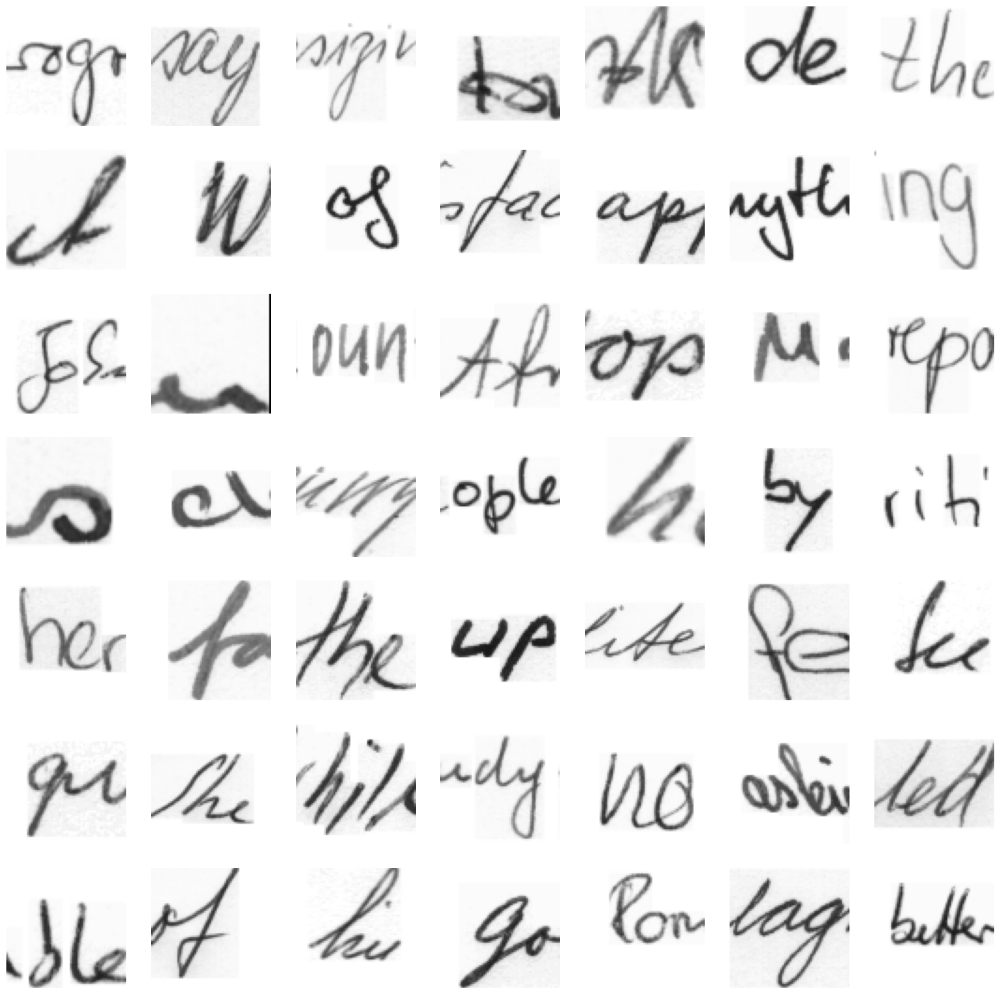

In [ ]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

In [ ]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/4879 [00:00<?, ?it/s]

In [ ]:
train_images[0].shape

(64, 64, 3)

In [ ]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [ ]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [ ]:
train_images[0]

array([[[1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        ...,
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ]],

       [[1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        ...,
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ]],

       [[1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        ...,
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ]],

       ...,

       [[1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1

In [ ]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

In [ ]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_4 (Dense)             (None, 32768)             3309568   
                                                                 
 re_lu_8 (ReLU)              (None, 32768)             0         
                                                                 
 reshape_2 (Reshape)         (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose_6 (Conv2DT  (None, 16, 16, 256)      2097408   
 ranspose)                                                       
                                                                 
 re_lu_9 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_7 (Conv2DT  (None, 32, 32, 128)      524416    
 ranspose)                                               

In [ ]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(256, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization_6 (Batc  (None, 32, 32, 64)       256       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_10 (Conv2D)          (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_7 (Batc  (None, 16, 16, 128)      512       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_7 (LeakyReLU)   (None, 16, 16, 128)     

In [ ]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [ ]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [ ]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/80
153/153 [==============================] - ETA: 0s - d_loss: 0.7413 - g_loss: 3.1815

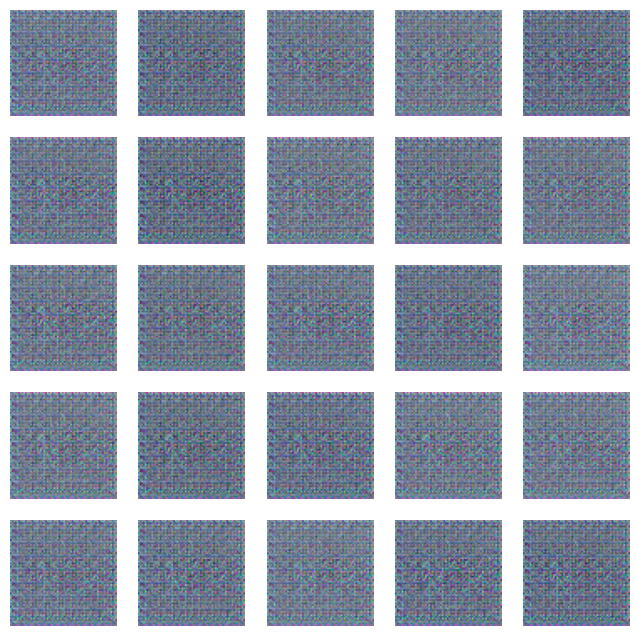

153/153 [==============================] - 370s 2s/step - d_loss: 0.7413 - g_loss: 3.1815
Epoch 2/80
153/153 [==============================] - ETA: 0s - d_loss: -0.0956 - g_loss: 5.2472

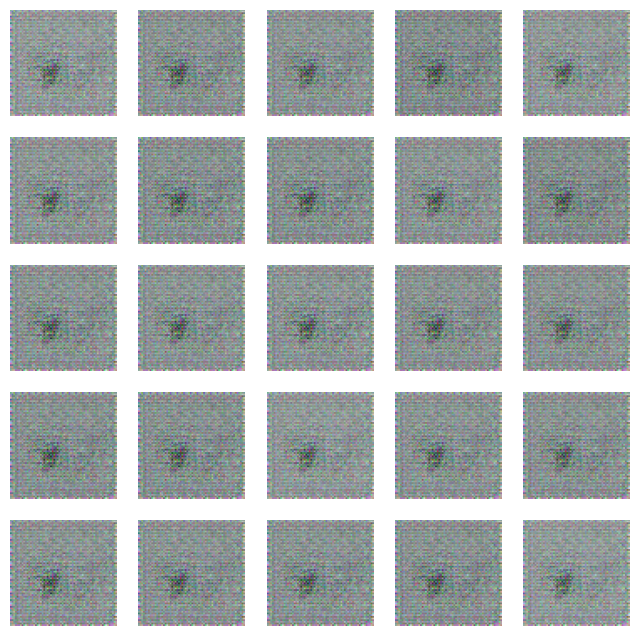

153/153 [==============================] - 367s 2s/step - d_loss: -0.0956 - g_loss: 5.2472
Epoch 3/80
153/153 [==============================] - ETA: 0s - d_loss: 0.1215 - g_loss: 5.1236

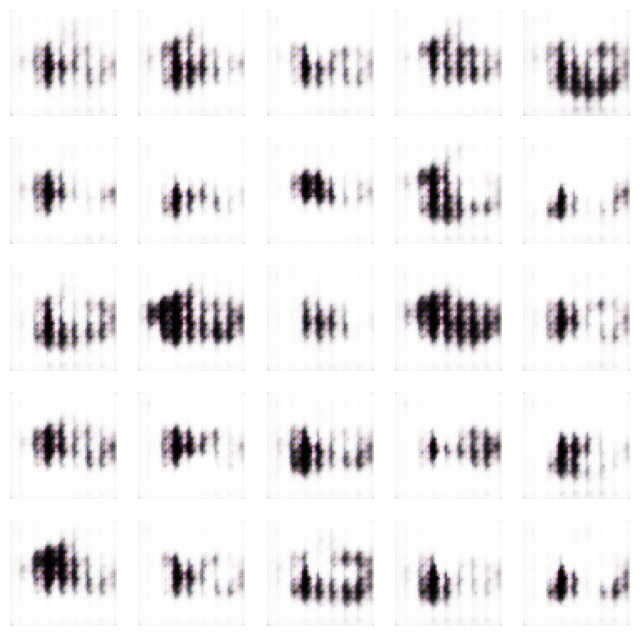

153/153 [==============================] - 367s 2s/step - d_loss: 0.1215 - g_loss: 5.1236
Epoch 4/80
153/153 [==============================] - ETA: 0s - d_loss: 0.2369 - g_loss: 3.4292

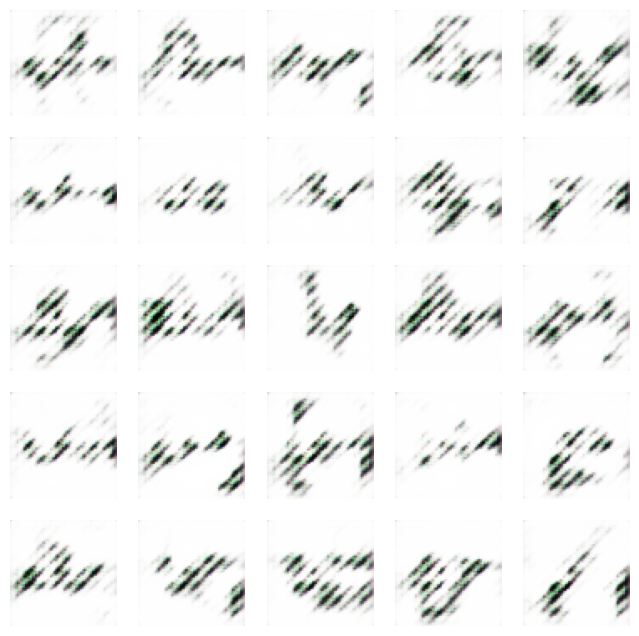

153/153 [==============================] - 366s 2s/step - d_loss: 0.2369 - g_loss: 3.4292
Epoch 5/80
153/153 [==============================] - ETA: 0s - d_loss: 0.2557 - g_loss: 2.9326

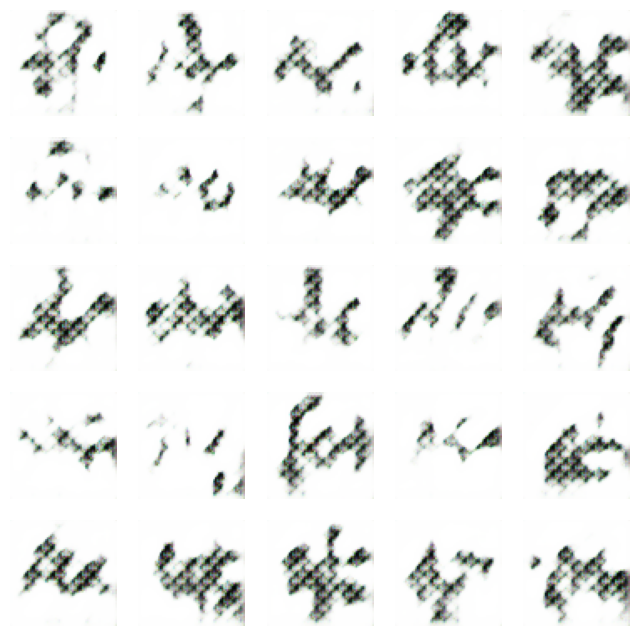

153/153 [==============================] - 367s 2s/step - d_loss: 0.2557 - g_loss: 2.9326
Epoch 6/80
153/153 [==============================] - ETA: 0s - d_loss: 0.3086 - g_loss: 2.7836

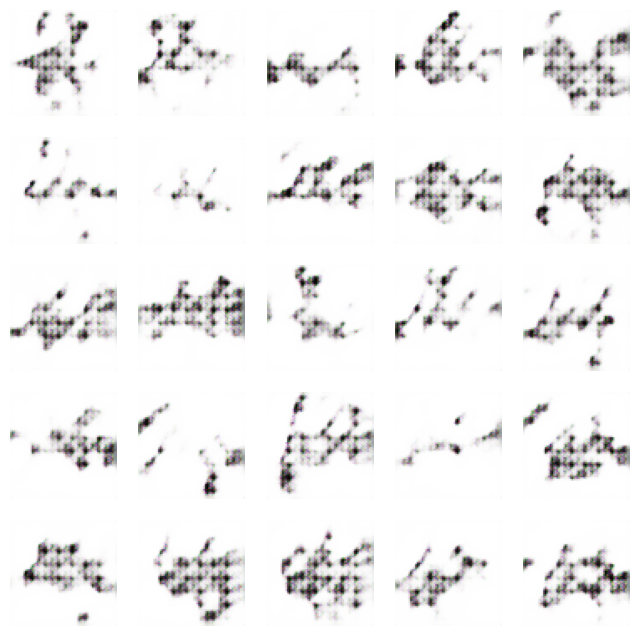

153/153 [==============================] - 367s 2s/step - d_loss: 0.3086 - g_loss: 2.7836
Epoch 7/80
153/153 [==============================] - ETA: 0s - d_loss: 0.3592 - g_loss: 2.8105

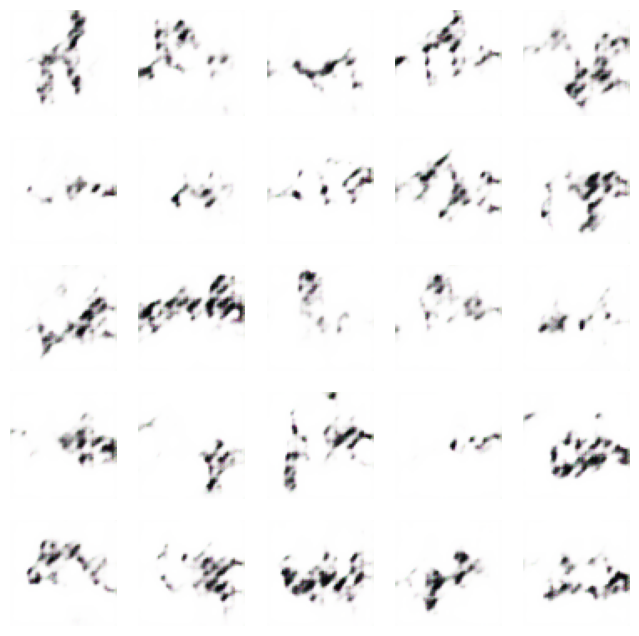

153/153 [==============================] - 366s 2s/step - d_loss: 0.3592 - g_loss: 2.8105
Epoch 8/80
153/153 [==============================] - ETA: 0s - d_loss: 0.2839 - g_loss: 2.7948

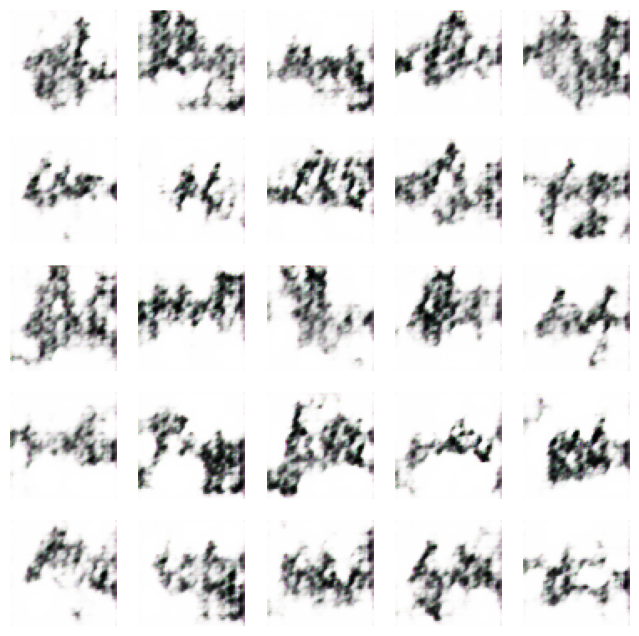

153/153 [==============================] - 364s 2s/step - d_loss: 0.2839 - g_loss: 2.7948
Epoch 9/80
153/153 [==============================] - ETA: 0s - d_loss: 0.2126 - g_loss: 2.9875

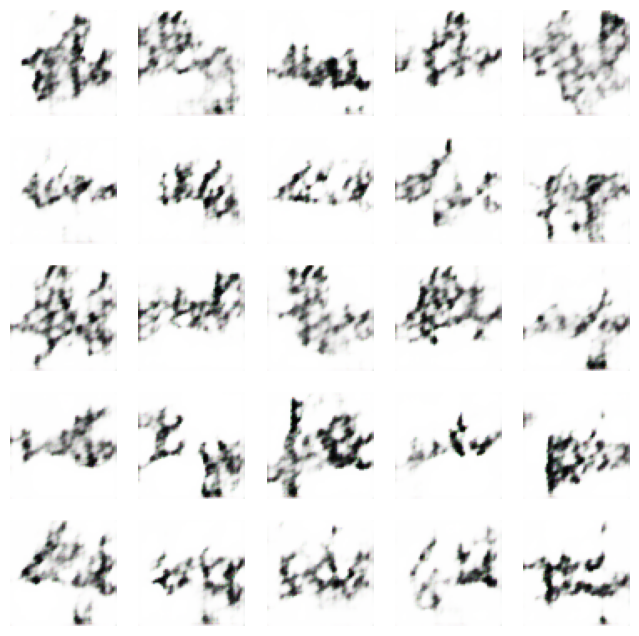

153/153 [==============================] - 366s 2s/step - d_loss: 0.2126 - g_loss: 2.9875
Epoch 10/80
153/153 [==============================] - ETA: 0s - d_loss: 0.1770 - g_loss: 3.0489

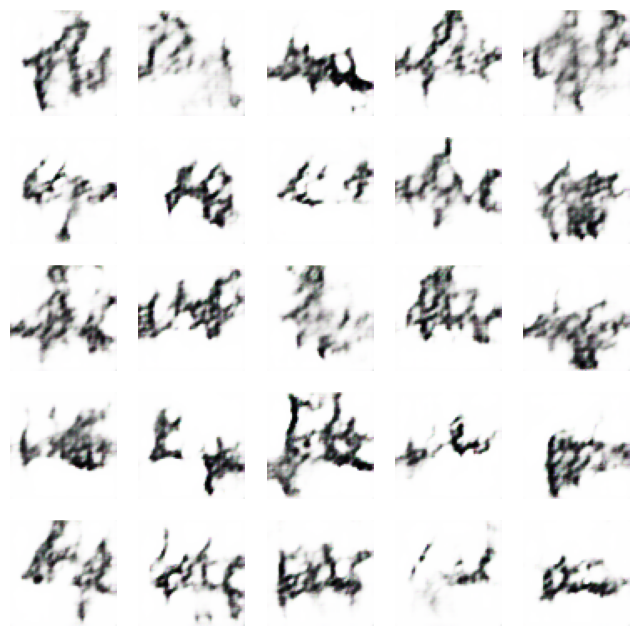

153/153 [==============================] - 366s 2s/step - d_loss: 0.1770 - g_loss: 3.0489
Epoch 11/80
153/153 [==============================] - ETA: 0s - d_loss: 0.2078 - g_loss: 2.9168

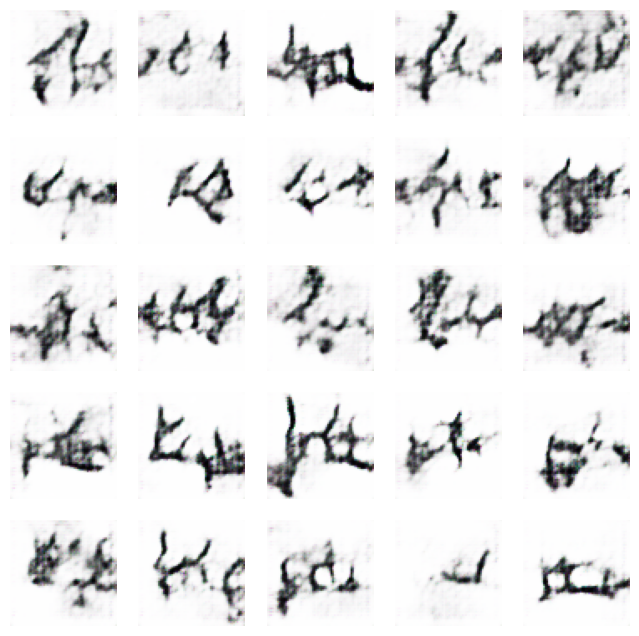

153/153 [==============================] - 366s 2s/step - d_loss: 0.2078 - g_loss: 2.9168
Epoch 12/80
153/153 [==============================] - ETA: 0s - d_loss: 0.3285 - g_loss: 2.4191

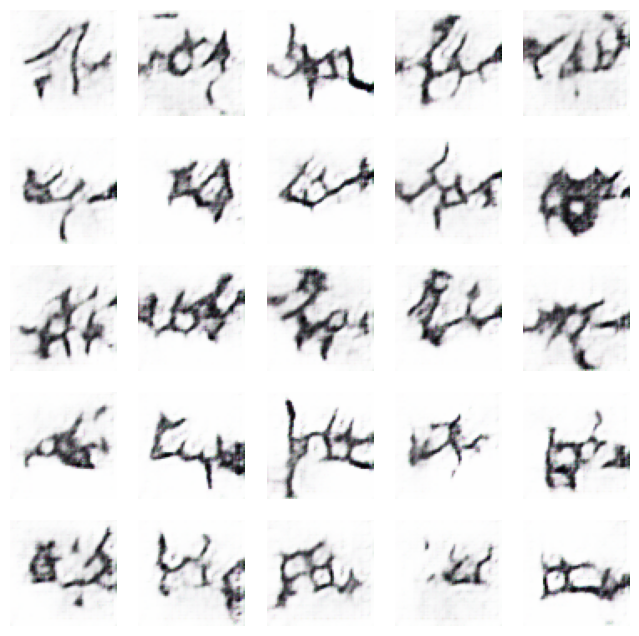

153/153 [==============================] - 363s 2s/step - d_loss: 0.3285 - g_loss: 2.4191
Epoch 13/80
153/153 [==============================] - ETA: 0s - d_loss: 0.3069 - g_loss: 2.1965

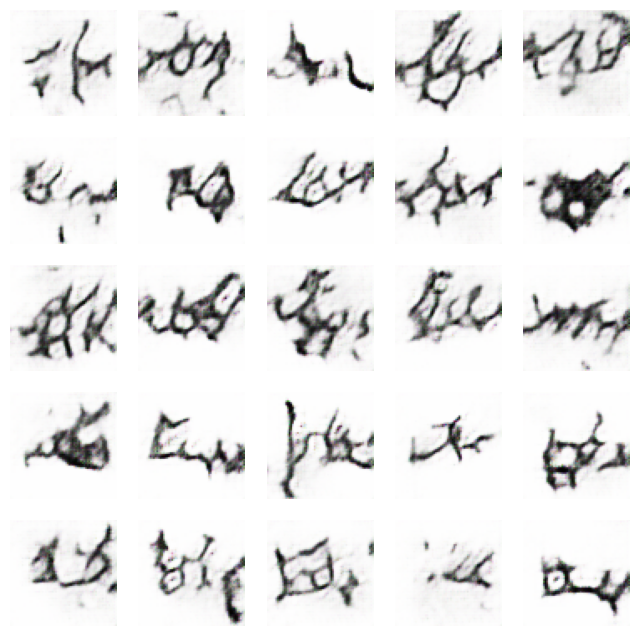

153/153 [==============================] - 367s 2s/step - d_loss: 0.3069 - g_loss: 2.1965
Epoch 14/80
153/153 [==============================] - ETA: 0s - d_loss: 0.3045 - g_loss: 2.2146

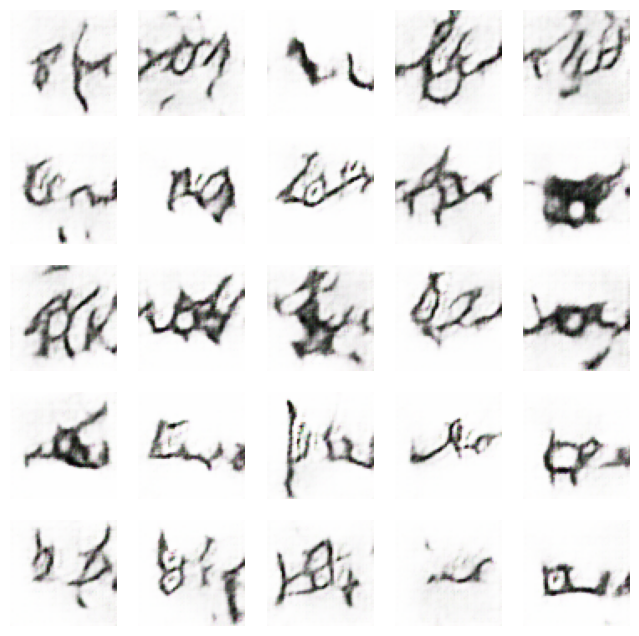

153/153 [==============================] - 367s 2s/step - d_loss: 0.3045 - g_loss: 2.2146
Epoch 15/80
153/153 [==============================] - ETA: 0s - d_loss: 0.3324 - g_loss: 2.1183

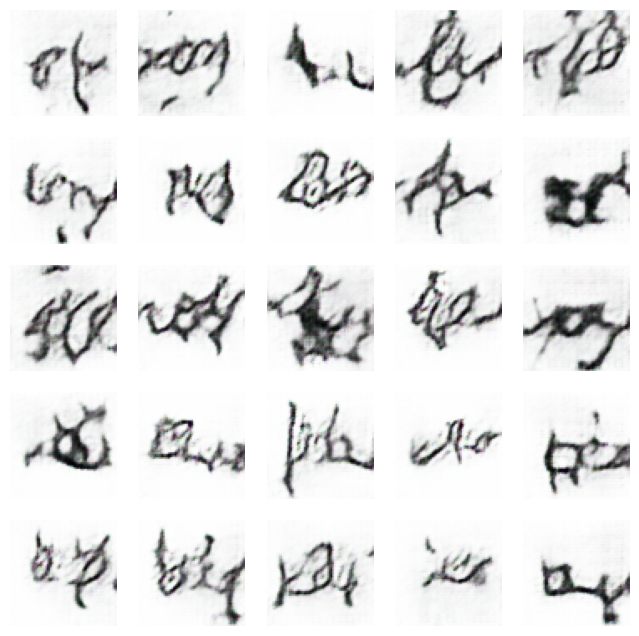

153/153 [==============================] - 369s 2s/step - d_loss: 0.3324 - g_loss: 2.1183
Epoch 16/80
153/153 [==============================] - ETA: 0s - d_loss: 0.3434 - g_loss: 2.0562

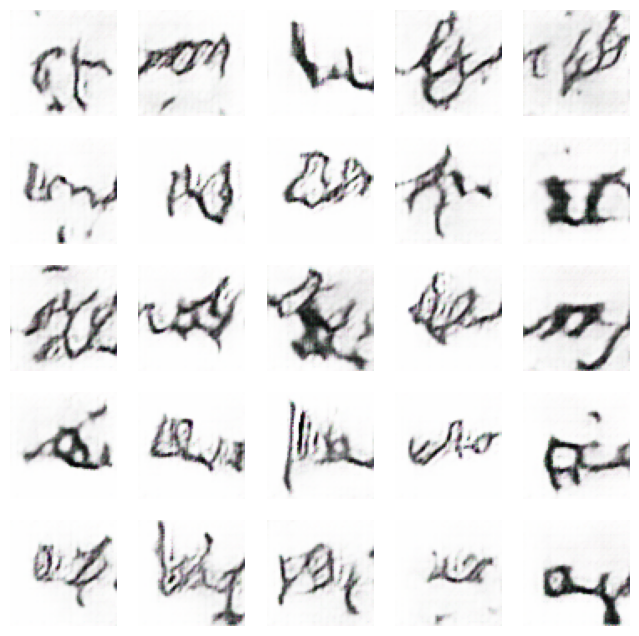

153/153 [==============================] - 369s 2s/step - d_loss: 0.3434 - g_loss: 2.0562
Epoch 17/80
153/153 [==============================] - ETA: 0s - d_loss: 0.3912 - g_loss: 1.9979

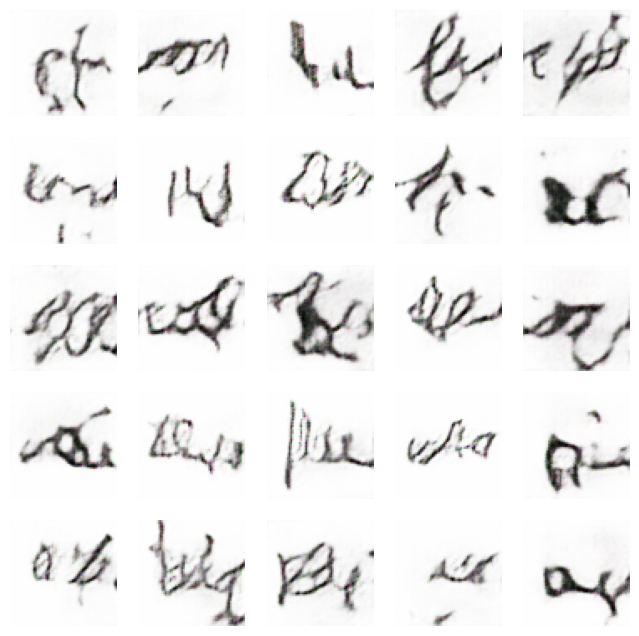

153/153 [==============================] - 367s 2s/step - d_loss: 0.3912 - g_loss: 1.9979
Epoch 18/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4114 - g_loss: 1.9902

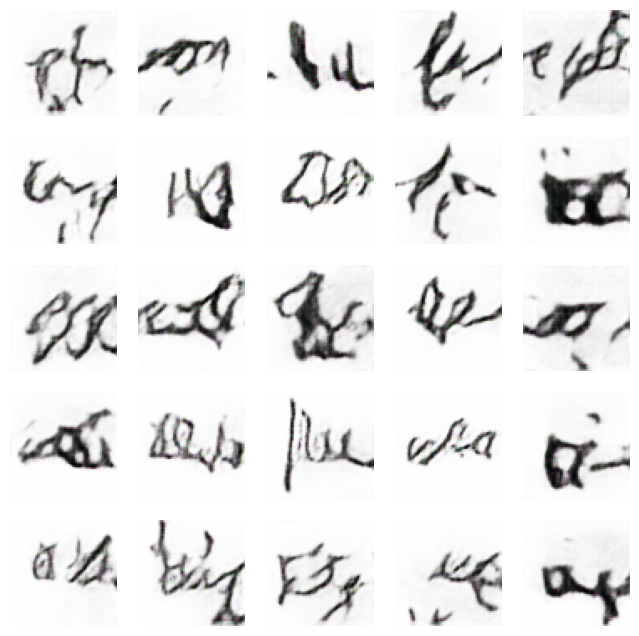

153/153 [==============================] - 367s 2s/step - d_loss: 0.4114 - g_loss: 1.9902
Epoch 19/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4150 - g_loss: 1.8648

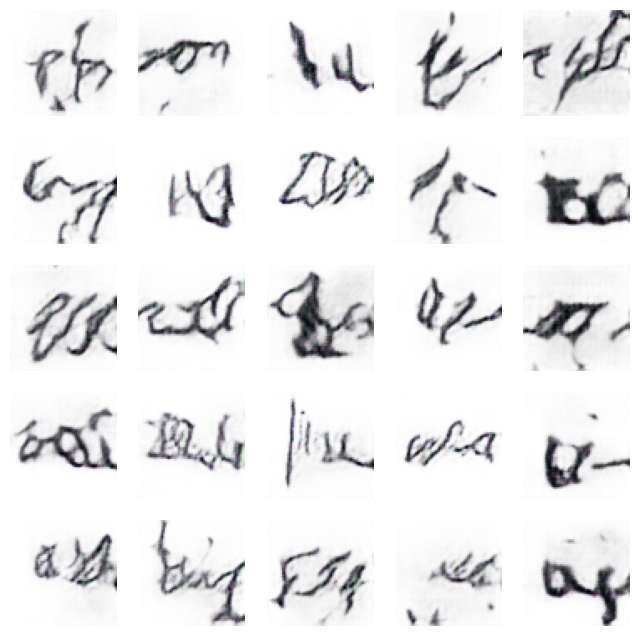

153/153 [==============================] - 368s 2s/step - d_loss: 0.4150 - g_loss: 1.8648
Epoch 20/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4154 - g_loss: 1.8339

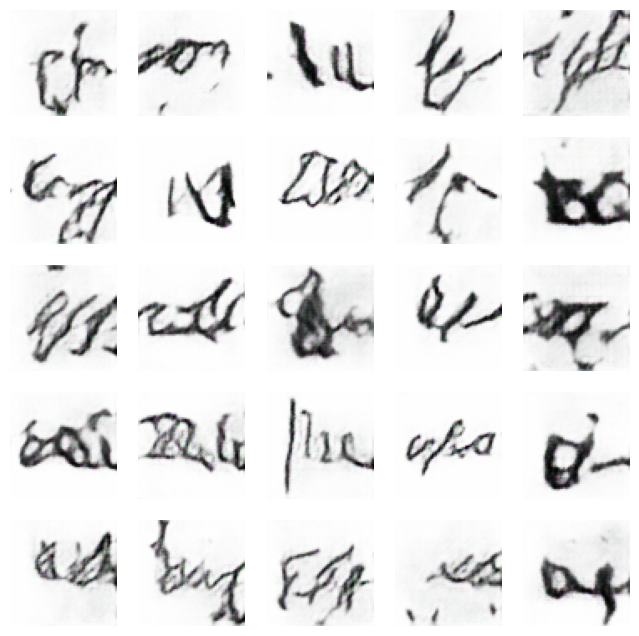

153/153 [==============================] - 367s 2s/step - d_loss: 0.4154 - g_loss: 1.8339
Epoch 21/80
153/153 [==============================] - ETA: 0s - d_loss: 0.3971 - g_loss: 1.9171

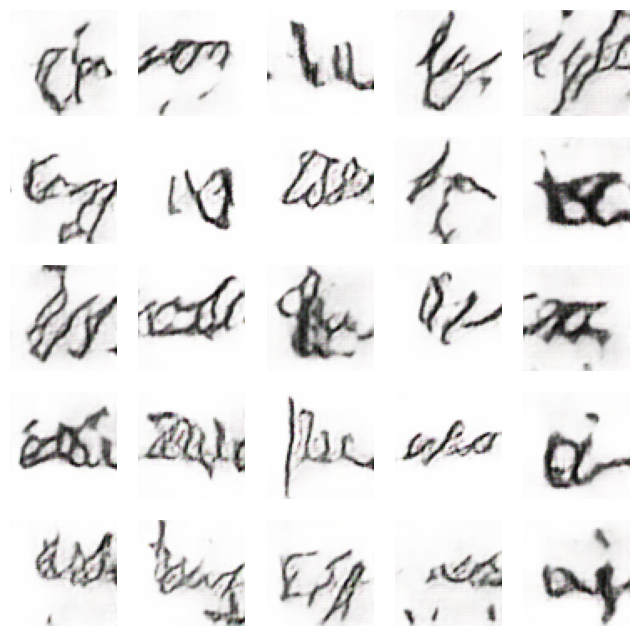

153/153 [==============================] - 368s 2s/step - d_loss: 0.3971 - g_loss: 1.9171
Epoch 22/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4405 - g_loss: 1.8356

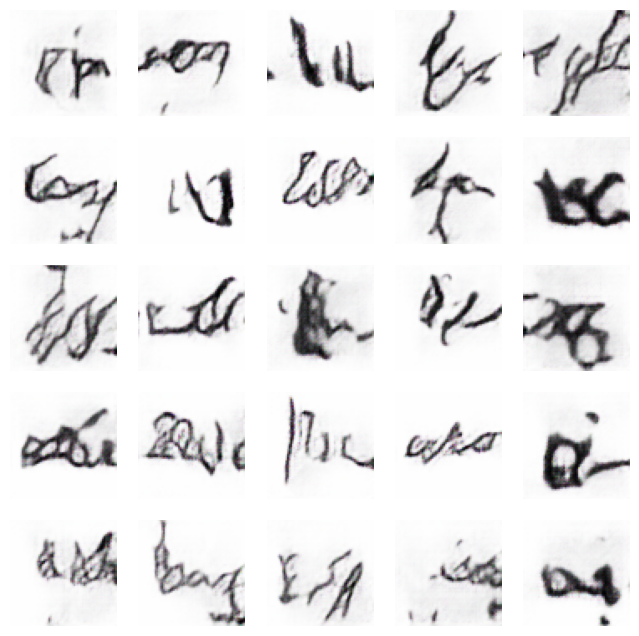

153/153 [==============================] - 368s 2s/step - d_loss: 0.4405 - g_loss: 1.8356
Epoch 23/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4159 - g_loss: 1.8054

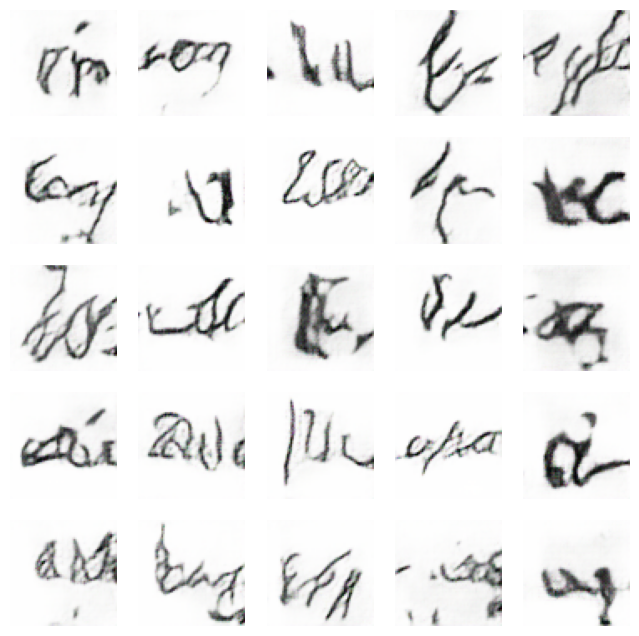

153/153 [==============================] - 368s 2s/step - d_loss: 0.4159 - g_loss: 1.8054
Epoch 24/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4401 - g_loss: 1.7833

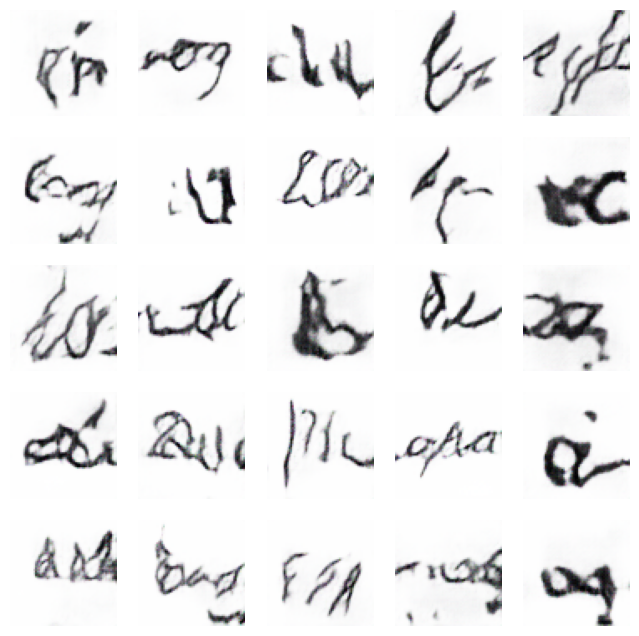

153/153 [==============================] - 368s 2s/step - d_loss: 0.4401 - g_loss: 1.7833
Epoch 25/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4462 - g_loss: 1.7803

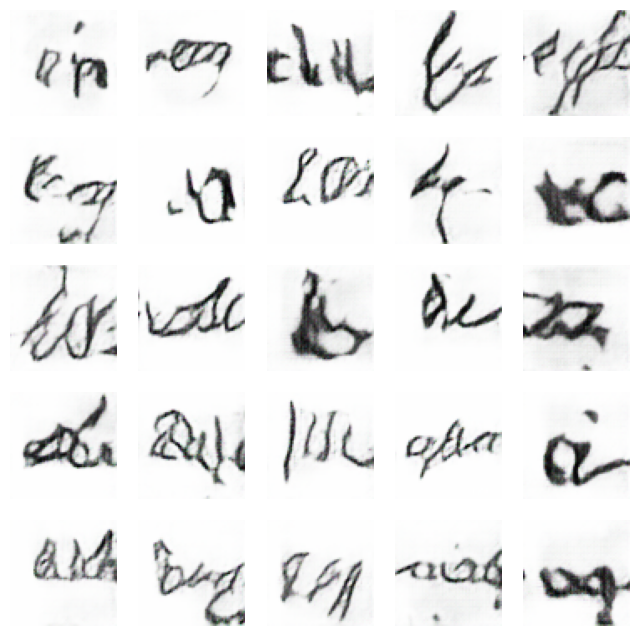

153/153 [==============================] - 368s 2s/step - d_loss: 0.4462 - g_loss: 1.7803
Epoch 26/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4641 - g_loss: 1.8069

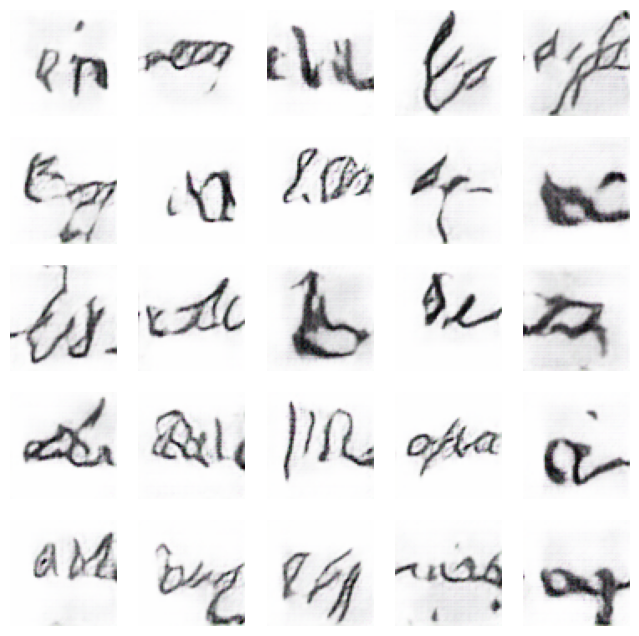

153/153 [==============================] - 368s 2s/step - d_loss: 0.4641 - g_loss: 1.8069
Epoch 27/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4647 - g_loss: 1.6646

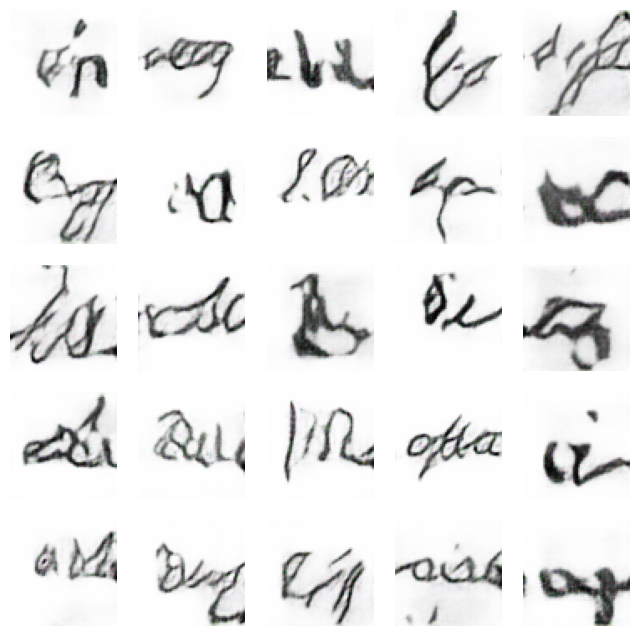

153/153 [==============================] - 367s 2s/step - d_loss: 0.4647 - g_loss: 1.6646
Epoch 28/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4447 - g_loss: 1.7405

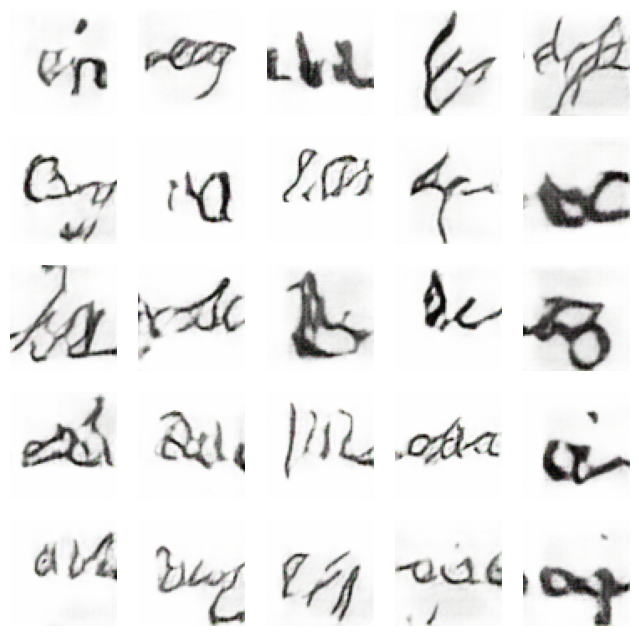

153/153 [==============================] - 366s 2s/step - d_loss: 0.4447 - g_loss: 1.7405
Epoch 29/80
153/153 [==============================] - ETA: 0s - d_loss: 0.5017 - g_loss: 1.7241

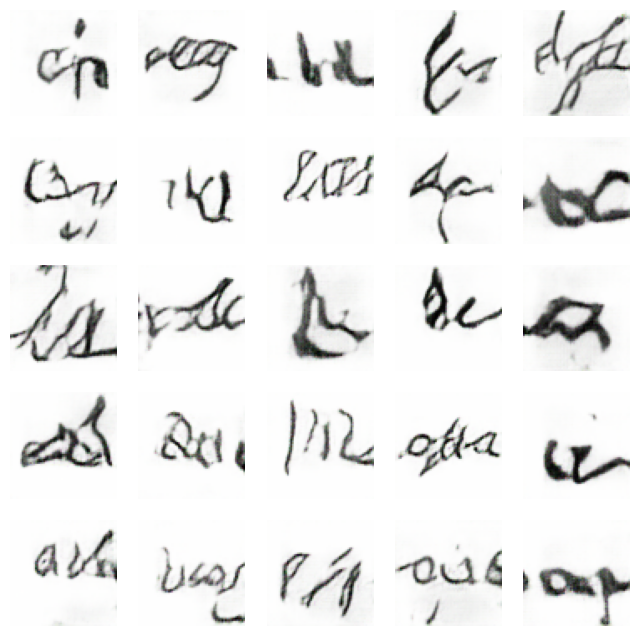

153/153 [==============================] - 367s 2s/step - d_loss: 0.5017 - g_loss: 1.7241
Epoch 30/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4546 - g_loss: 1.6569

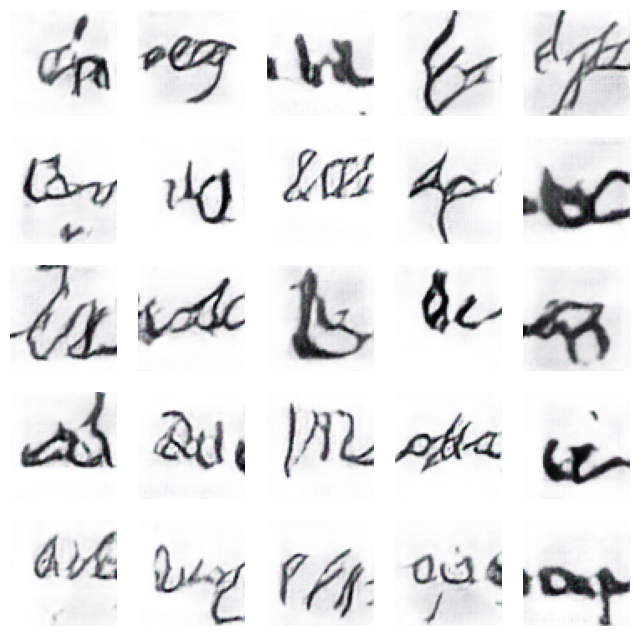

153/153 [==============================] - 366s 2s/step - d_loss: 0.4546 - g_loss: 1.6569
Epoch 31/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4680 - g_loss: 1.7560

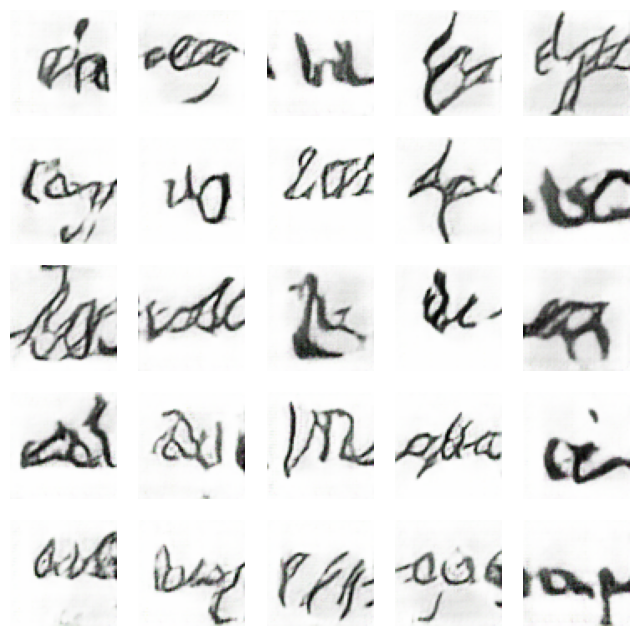

153/153 [==============================] - 369s 2s/step - d_loss: 0.4680 - g_loss: 1.7560
Epoch 32/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4942 - g_loss: 1.6338

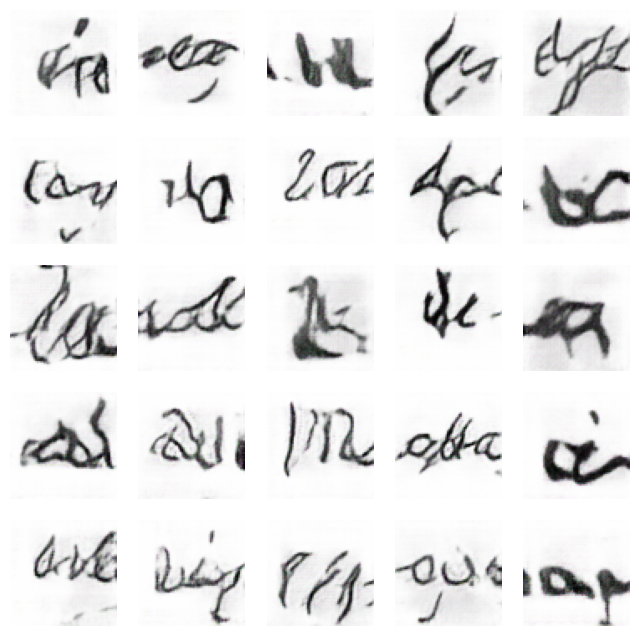

153/153 [==============================] - 367s 2s/step - d_loss: 0.4942 - g_loss: 1.6338
Epoch 33/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4956 - g_loss: 1.6835

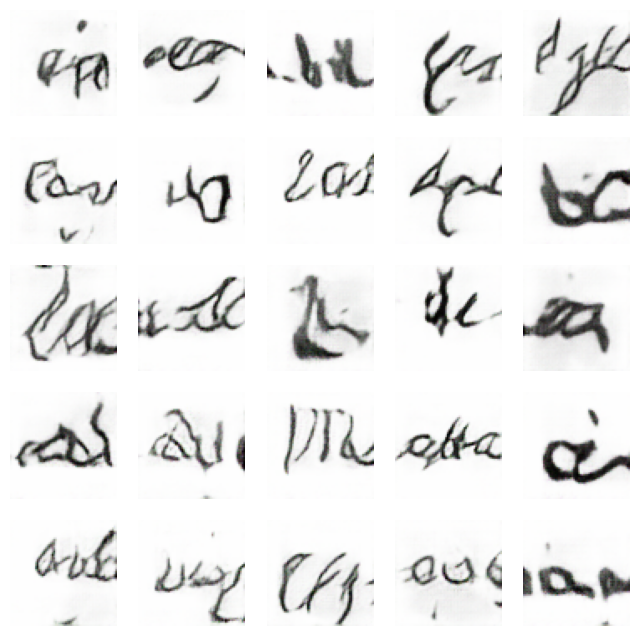

153/153 [==============================] - 375s 2s/step - d_loss: 0.4956 - g_loss: 1.6835
Epoch 34/80
153/153 [==============================] - ETA: 0s - d_loss: 0.5171 - g_loss: 1.6436

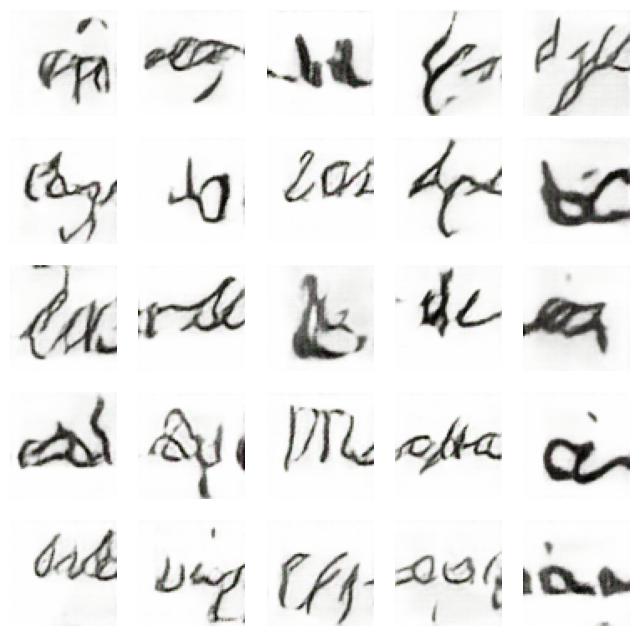

153/153 [==============================] - 372s 2s/step - d_loss: 0.5171 - g_loss: 1.6436
Epoch 35/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4792 - g_loss: 1.6501

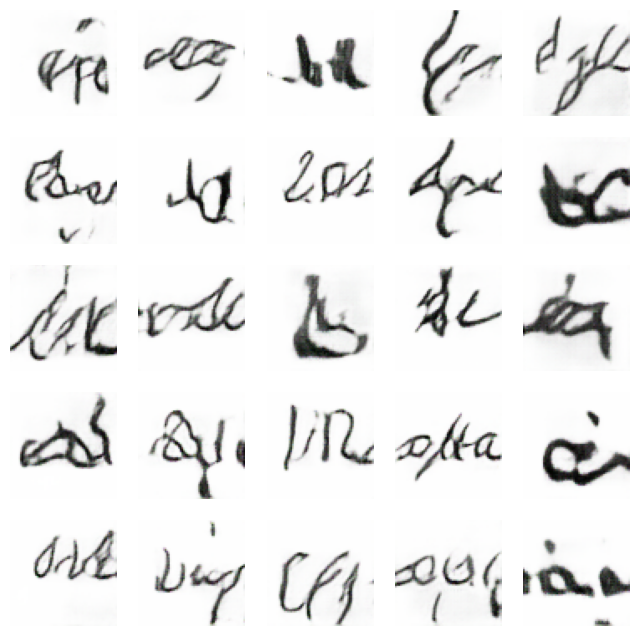

153/153 [==============================] - 368s 2s/step - d_loss: 0.4792 - g_loss: 1.6501
Epoch 36/80
153/153 [==============================] - ETA: 0s - d_loss: 0.5099 - g_loss: 1.6172

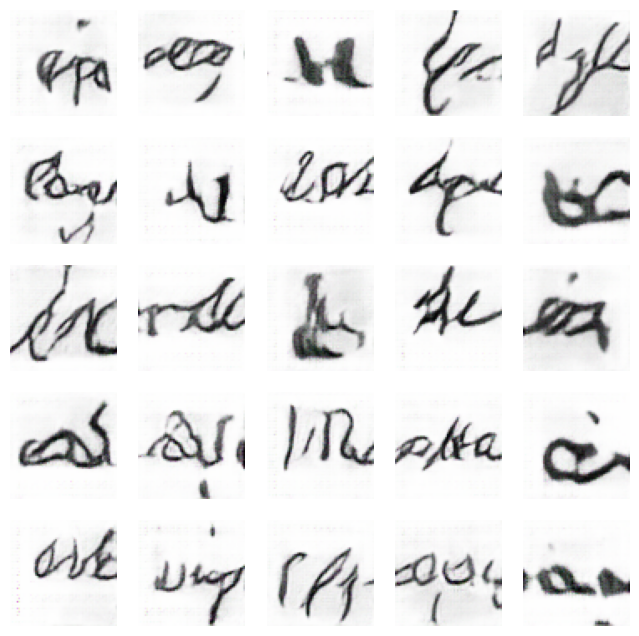

153/153 [==============================] - 368s 2s/step - d_loss: 0.5099 - g_loss: 1.6172
Epoch 37/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4894 - g_loss: 1.6387

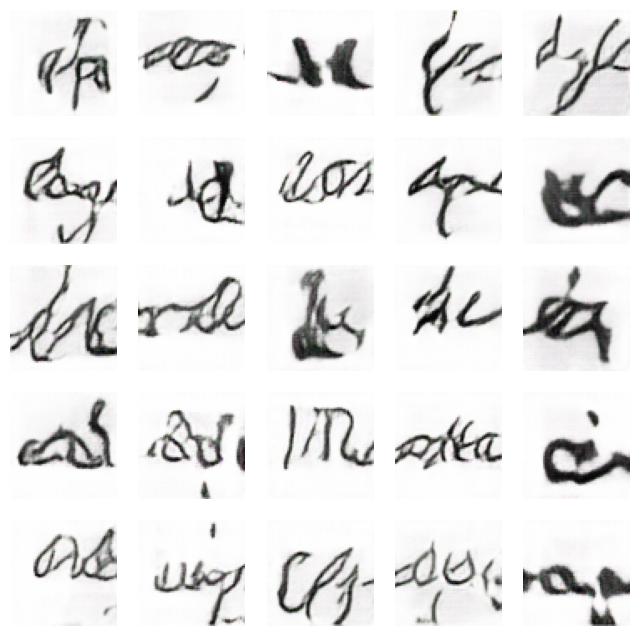

153/153 [==============================] - 369s 2s/step - d_loss: 0.4894 - g_loss: 1.6387
Epoch 38/80
153/153 [==============================] - ETA: 0s - d_loss: 0.5029 - g_loss: 1.6334

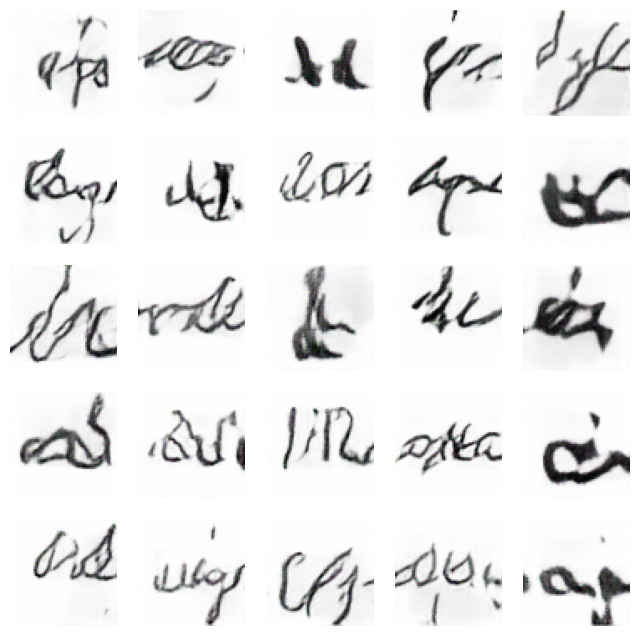

153/153 [==============================] - 369s 2s/step - d_loss: 0.5029 - g_loss: 1.6334
Epoch 39/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4832 - g_loss: 1.6669

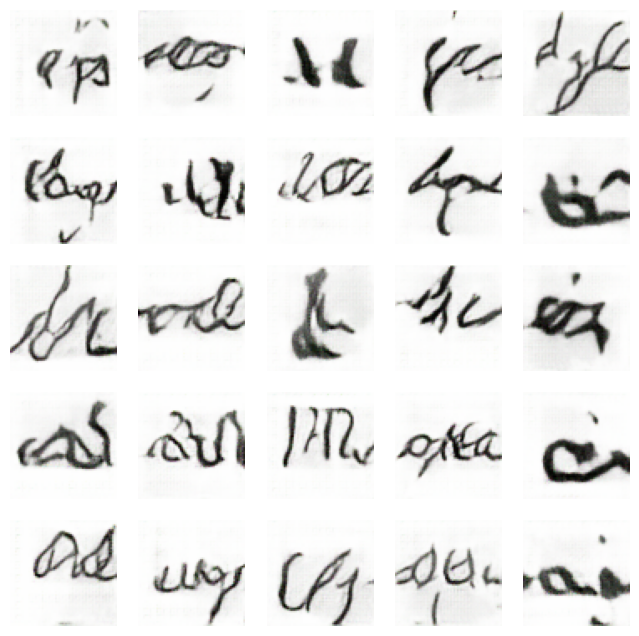

153/153 [==============================] - 371s 2s/step - d_loss: 0.4832 - g_loss: 1.6669
Epoch 40/80
153/153 [==============================] - ETA: 0s - d_loss: 0.5105 - g_loss: 1.6236

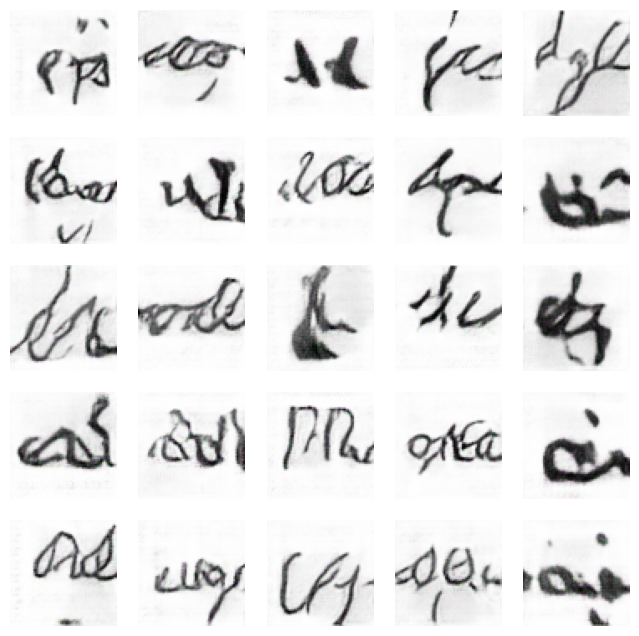

153/153 [==============================] - 368s 2s/step - d_loss: 0.5105 - g_loss: 1.6236
Epoch 41/80
153/153 [==============================] - ETA: 0s - d_loss: 0.5021 - g_loss: 1.6305

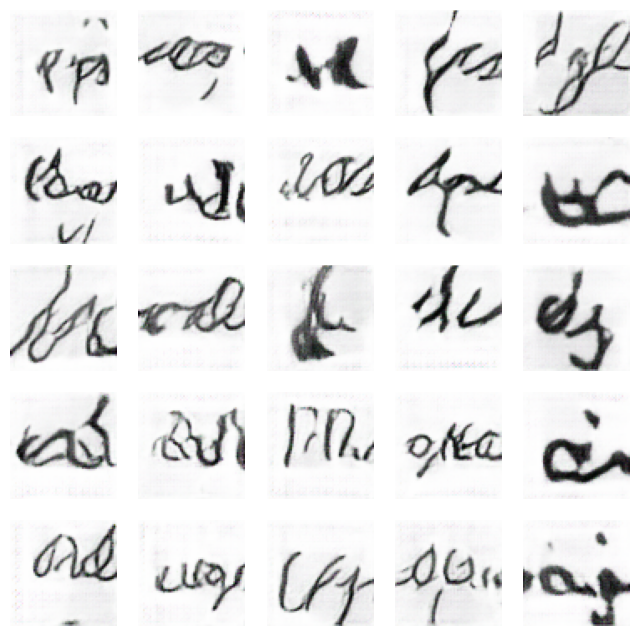

153/153 [==============================] - 369s 2s/step - d_loss: 0.5021 - g_loss: 1.6305
Epoch 42/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4844 - g_loss: 1.6529

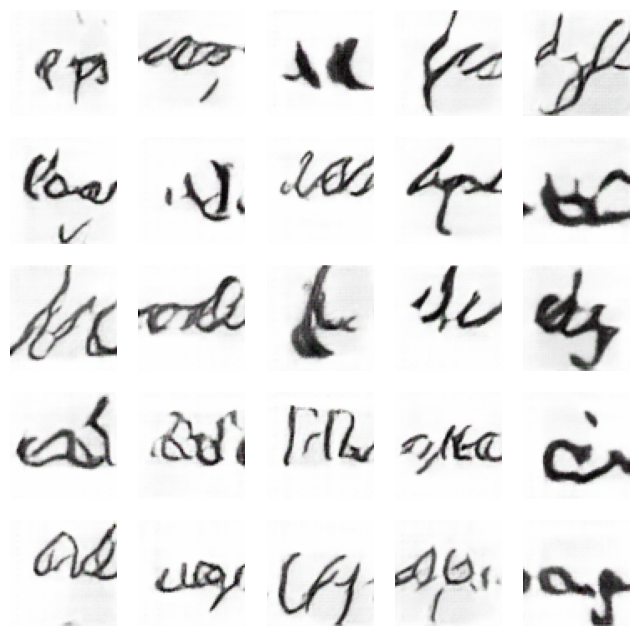

153/153 [==============================] - 366s 2s/step - d_loss: 0.4844 - g_loss: 1.6529
Epoch 43/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4958 - g_loss: 1.6264

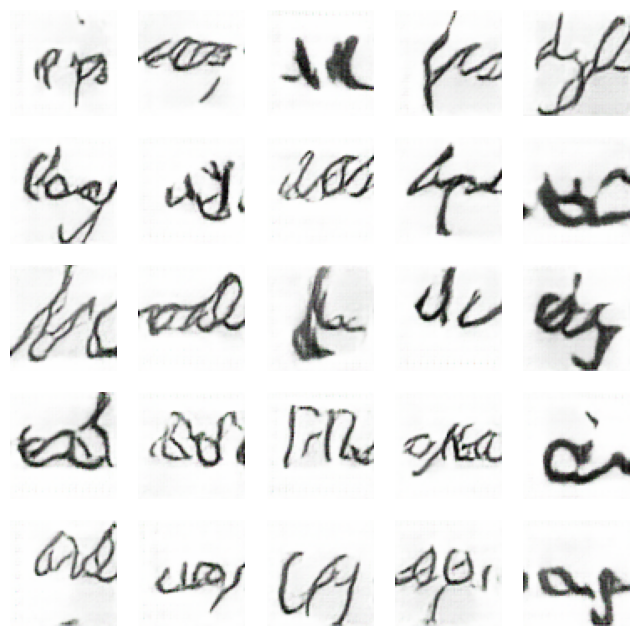

153/153 [==============================] - 368s 2s/step - d_loss: 0.4958 - g_loss: 1.6264
Epoch 44/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4823 - g_loss: 1.6259

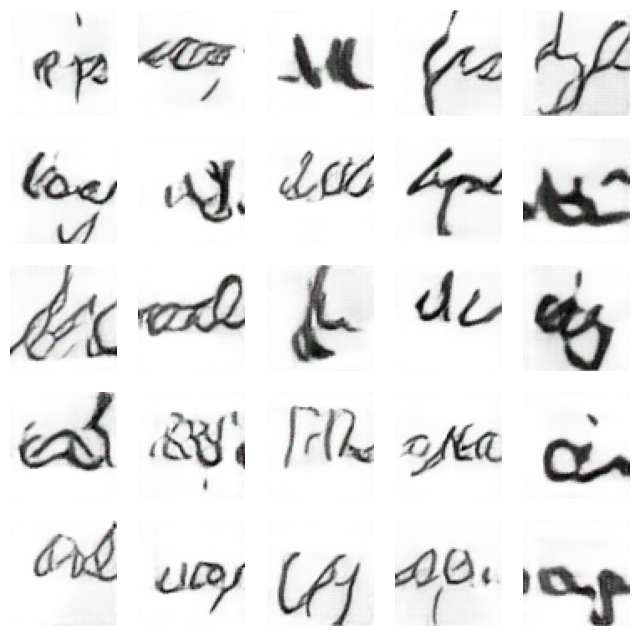

153/153 [==============================] - 371s 2s/step - d_loss: 0.4823 - g_loss: 1.6259
Epoch 45/80
153/153 [==============================] - ETA: 0s - d_loss: 0.5011 - g_loss: 1.5965

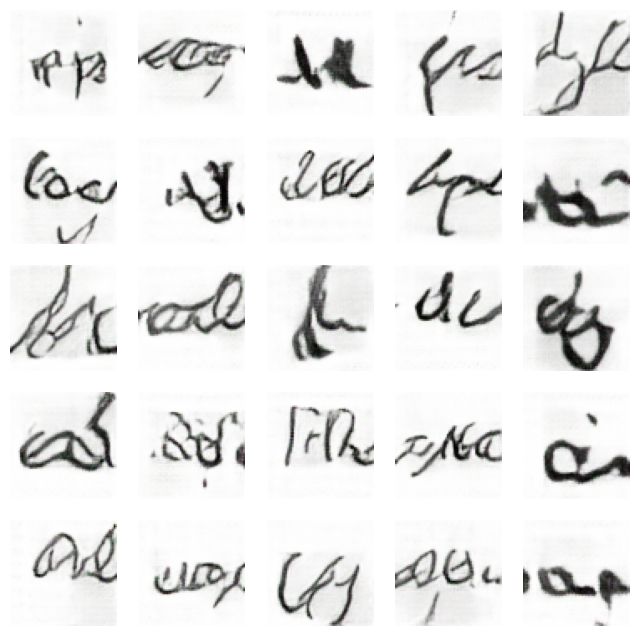

153/153 [==============================] - 370s 2s/step - d_loss: 0.5011 - g_loss: 1.5965
Epoch 46/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4892 - g_loss: 1.6228

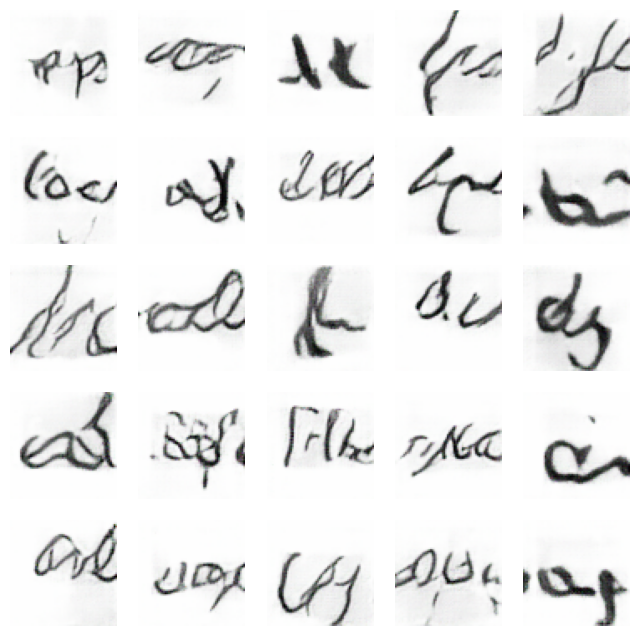

153/153 [==============================] - 368s 2s/step - d_loss: 0.4892 - g_loss: 1.6228
Epoch 47/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4981 - g_loss: 1.6153

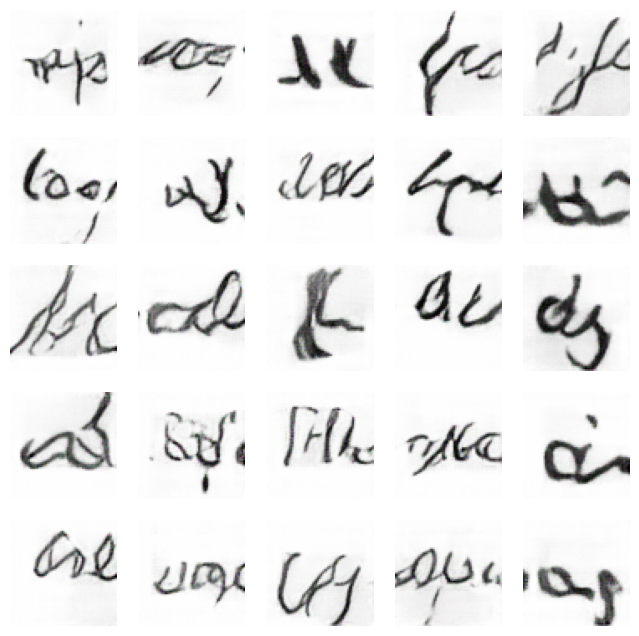

153/153 [==============================] - 369s 2s/step - d_loss: 0.4981 - g_loss: 1.6153
Epoch 48/80
153/153 [==============================] - ETA: 0s - d_loss: 0.5111 - g_loss: 1.6337

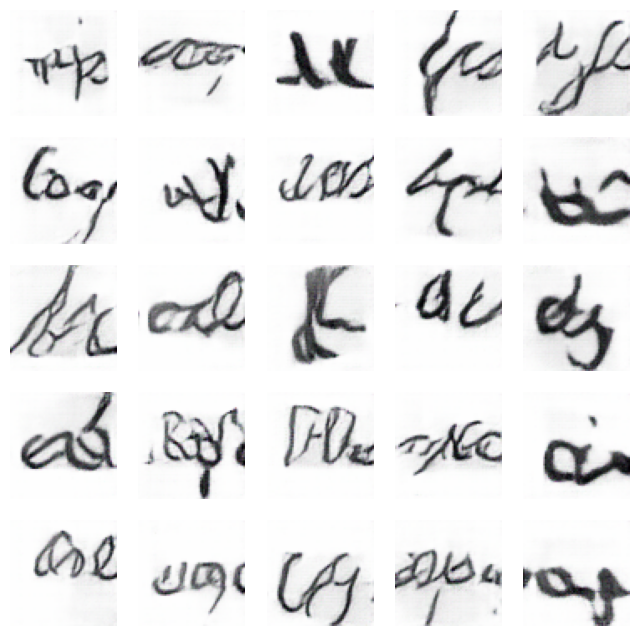

153/153 [==============================] - 370s 2s/step - d_loss: 0.5111 - g_loss: 1.6337
Epoch 49/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4881 - g_loss: 1.5693

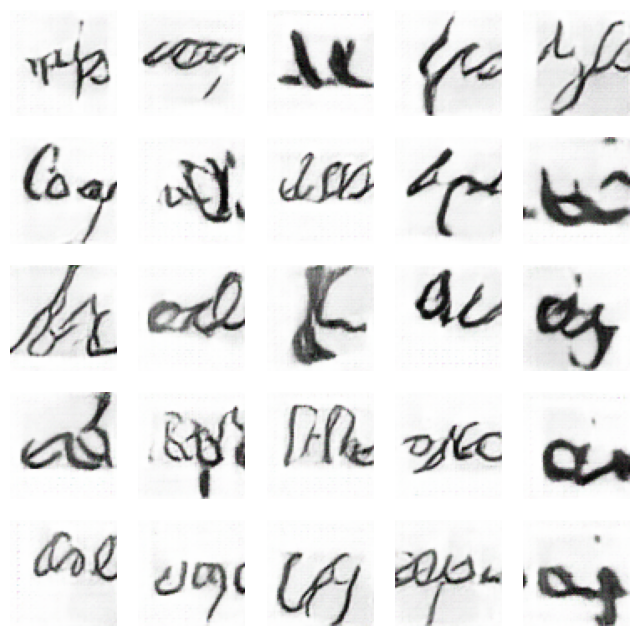

153/153 [==============================] - 371s 2s/step - d_loss: 0.4881 - g_loss: 1.5693
Epoch 50/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4811 - g_loss: 1.5949

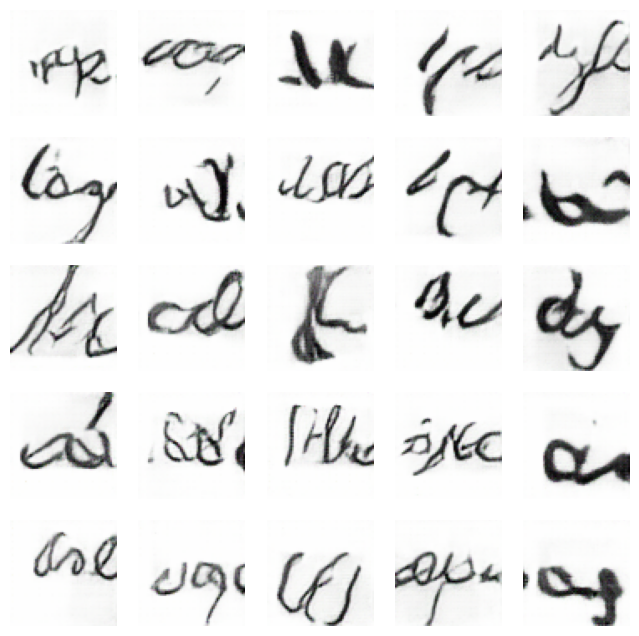

153/153 [==============================] - 373s 2s/step - d_loss: 0.4811 - g_loss: 1.5949
Epoch 51/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4900 - g_loss: 1.6770

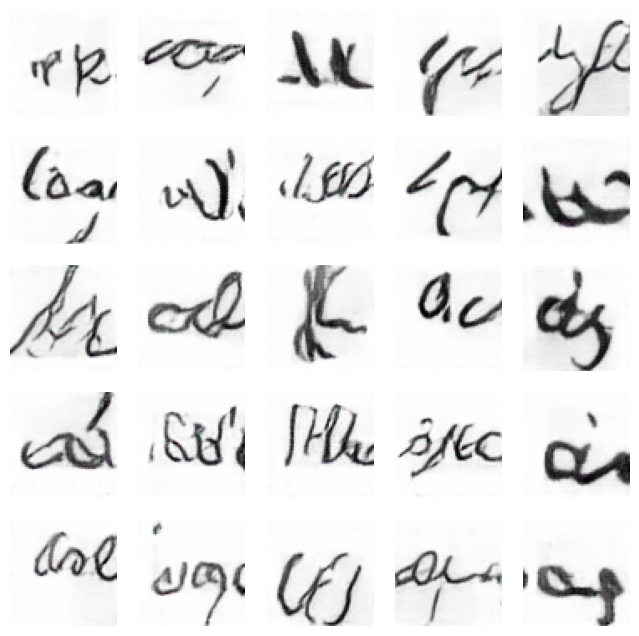

153/153 [==============================] - 373s 2s/step - d_loss: 0.4900 - g_loss: 1.6770
Epoch 52/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4832 - g_loss: 1.6357

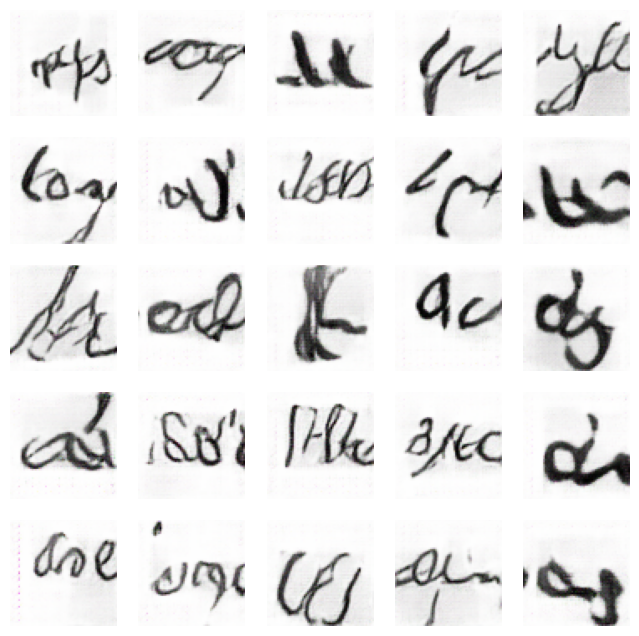

153/153 [==============================] - 372s 2s/step - d_loss: 0.4832 - g_loss: 1.6357
Epoch 53/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4788 - g_loss: 1.6172

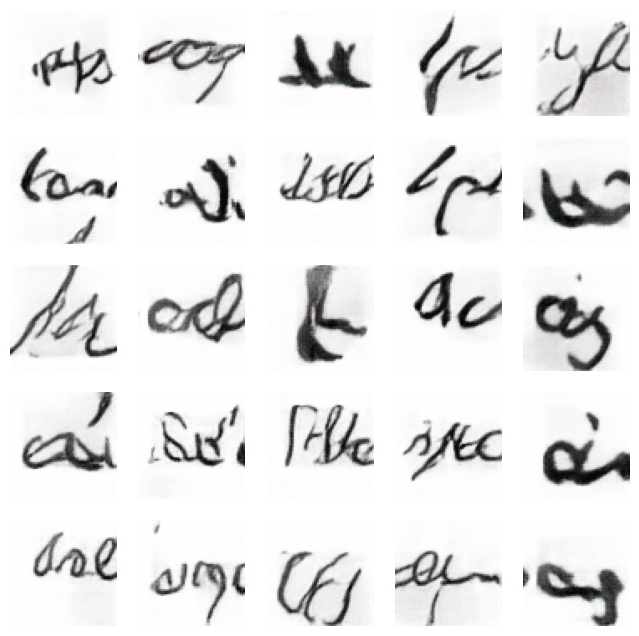

153/153 [==============================] - 372s 2s/step - d_loss: 0.4788 - g_loss: 1.6172
Epoch 54/80
153/153 [==============================] - ETA: 0s - d_loss: 0.5037 - g_loss: 1.6640

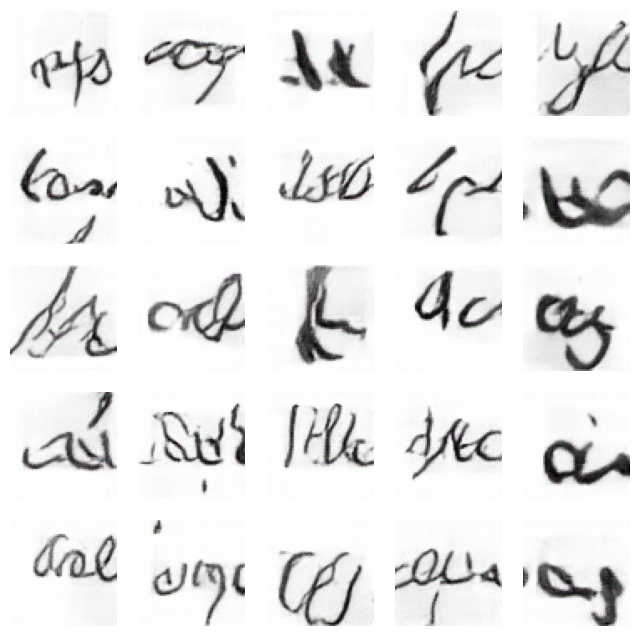

153/153 [==============================] - 375s 2s/step - d_loss: 0.5037 - g_loss: 1.6640
Epoch 55/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4835 - g_loss: 1.6635

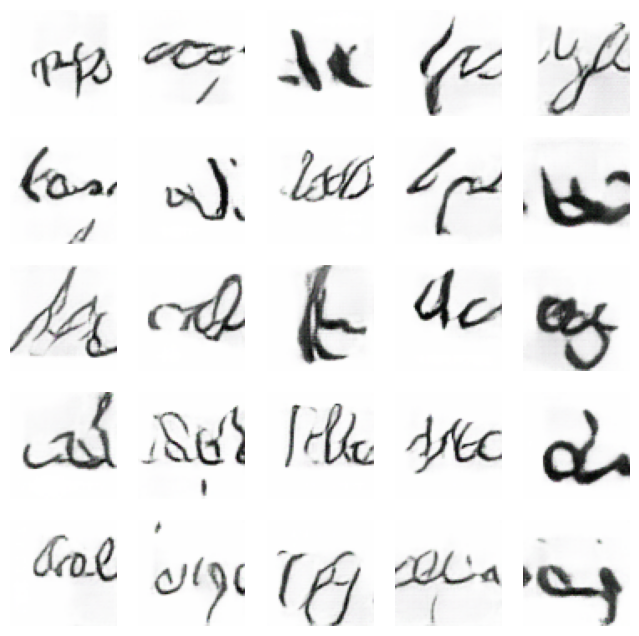

153/153 [==============================] - 373s 2s/step - d_loss: 0.4835 - g_loss: 1.6635
Epoch 56/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4863 - g_loss: 1.6192

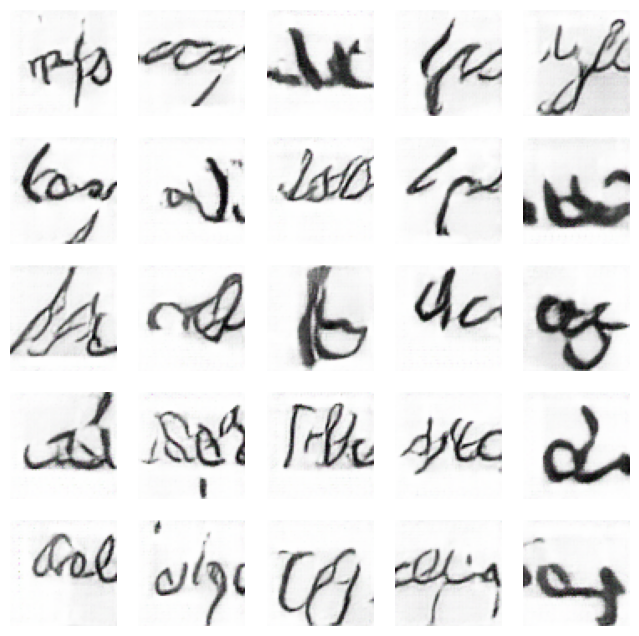

153/153 [==============================] - 375s 2s/step - d_loss: 0.4863 - g_loss: 1.6192
Epoch 57/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4758 - g_loss: 1.6350

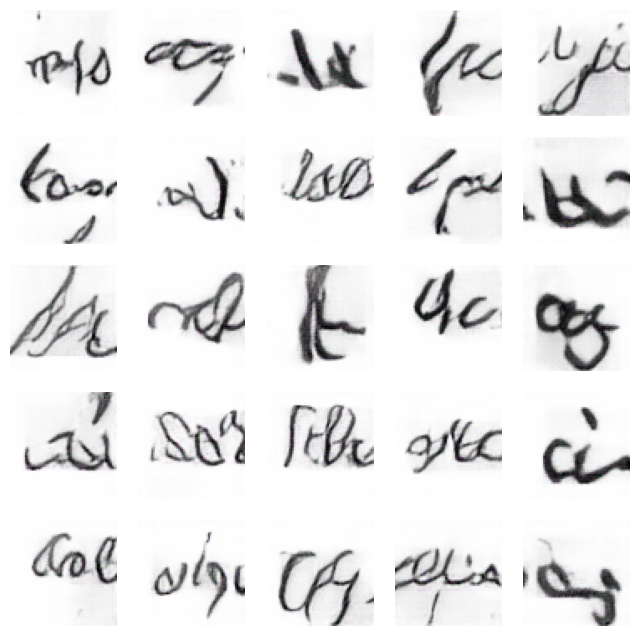

153/153 [==============================] - 373s 2s/step - d_loss: 0.4758 - g_loss: 1.6350
Epoch 58/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4726 - g_loss: 1.6625

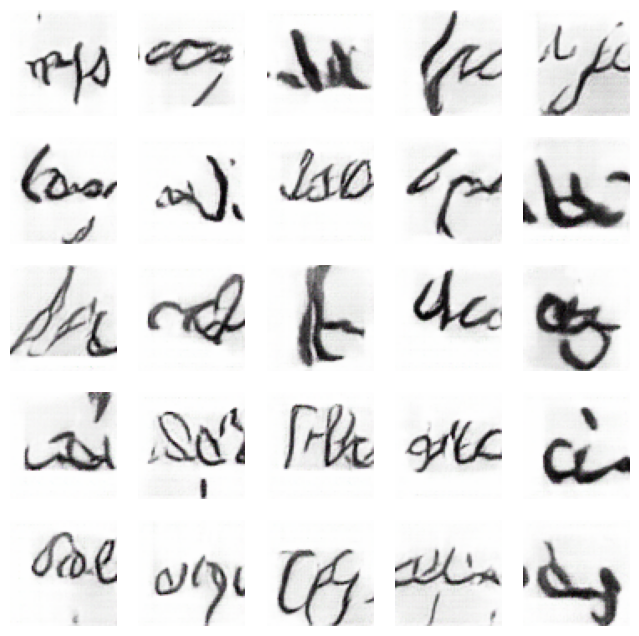

153/153 [==============================] - 374s 2s/step - d_loss: 0.4726 - g_loss: 1.6625
Epoch 59/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4759 - g_loss: 1.6562

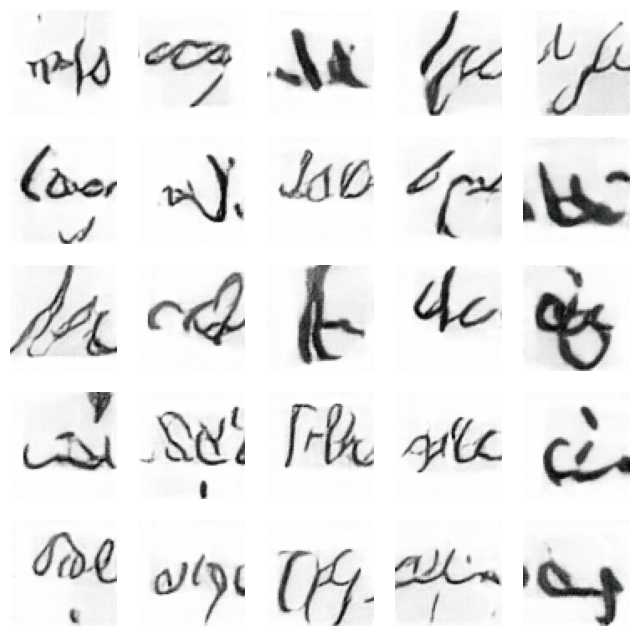

153/153 [==============================] - 373s 2s/step - d_loss: 0.4759 - g_loss: 1.6562
Epoch 60/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4871 - g_loss: 1.7012

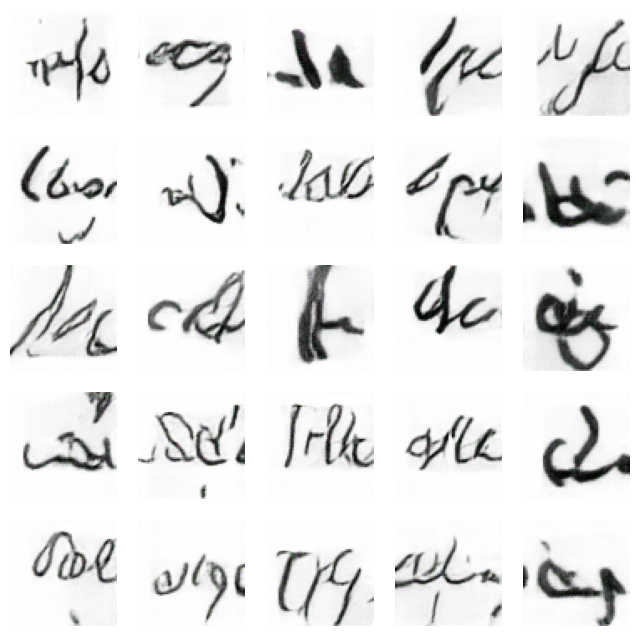

153/153 [==============================] - 374s 2s/step - d_loss: 0.4871 - g_loss: 1.7012
Epoch 61/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4821 - g_loss: 1.6917

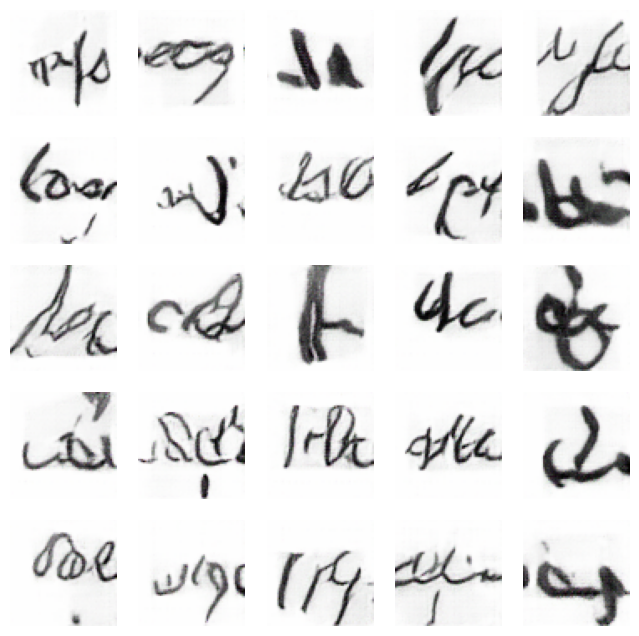

153/153 [==============================] - 375s 2s/step - d_loss: 0.4821 - g_loss: 1.6917
Epoch 62/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4718 - g_loss: 1.6682

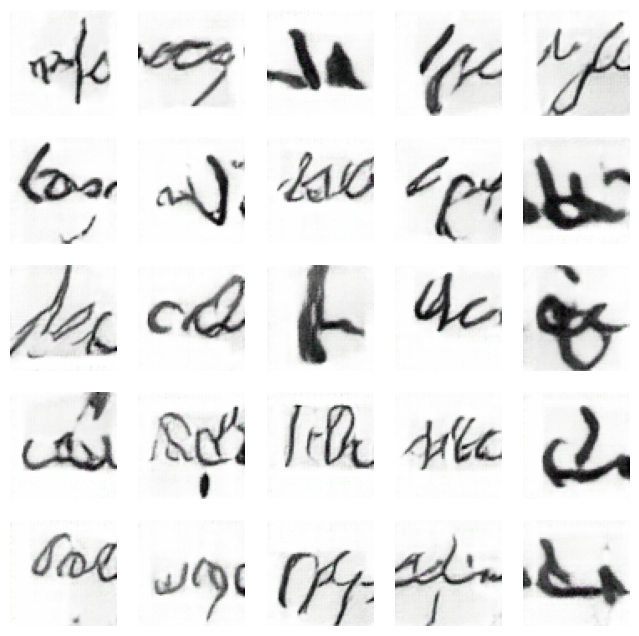

153/153 [==============================] - 374s 2s/step - d_loss: 0.4718 - g_loss: 1.6682
Epoch 63/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4657 - g_loss: 1.6932

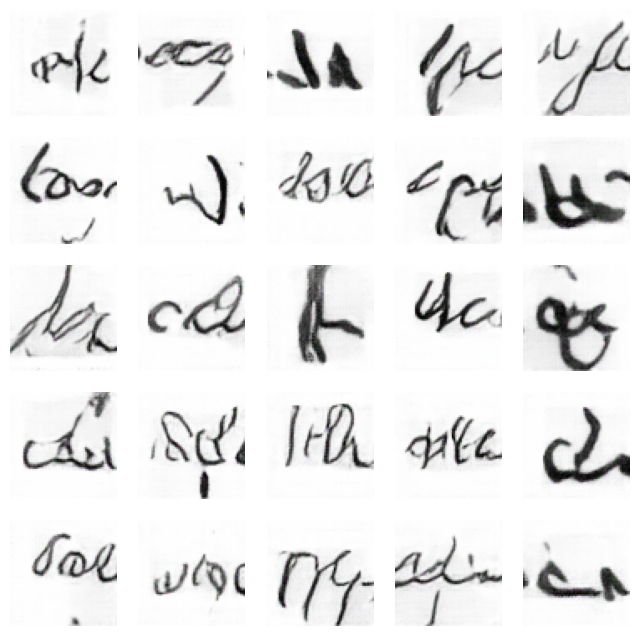

153/153 [==============================] - 374s 2s/step - d_loss: 0.4657 - g_loss: 1.6932
Epoch 64/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4720 - g_loss: 1.7222

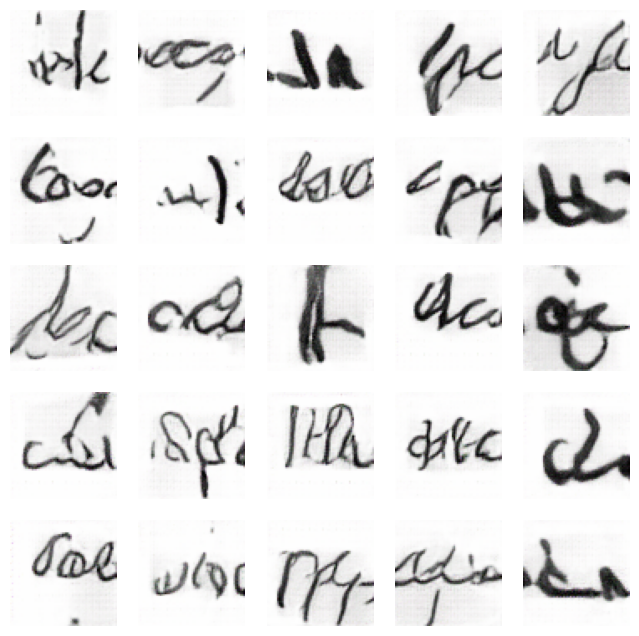

153/153 [==============================] - 372s 2s/step - d_loss: 0.4720 - g_loss: 1.7222
Epoch 65/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4531 - g_loss: 1.7333

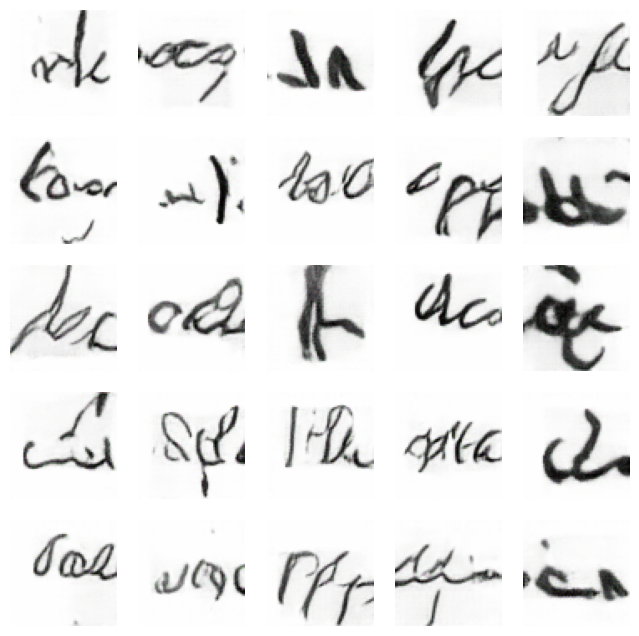

153/153 [==============================] - 374s 2s/step - d_loss: 0.4531 - g_loss: 1.7333
Epoch 66/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4471 - g_loss: 1.7365

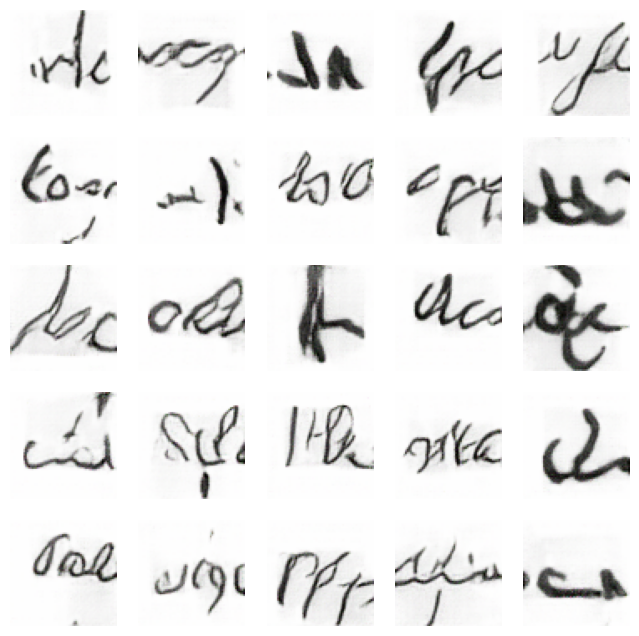

153/153 [==============================] - 374s 2s/step - d_loss: 0.4471 - g_loss: 1.7365
Epoch 67/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4577 - g_loss: 1.7919

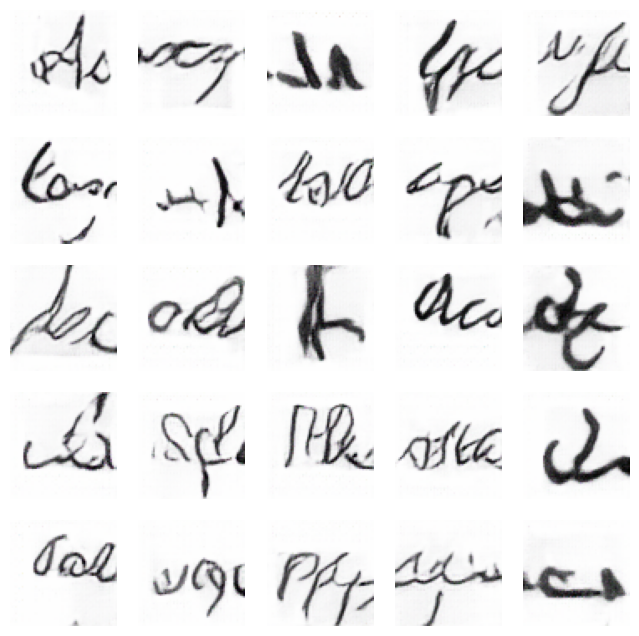

153/153 [==============================] - 372s 2s/step - d_loss: 0.4577 - g_loss: 1.7919
Epoch 68/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4668 - g_loss: 1.7393

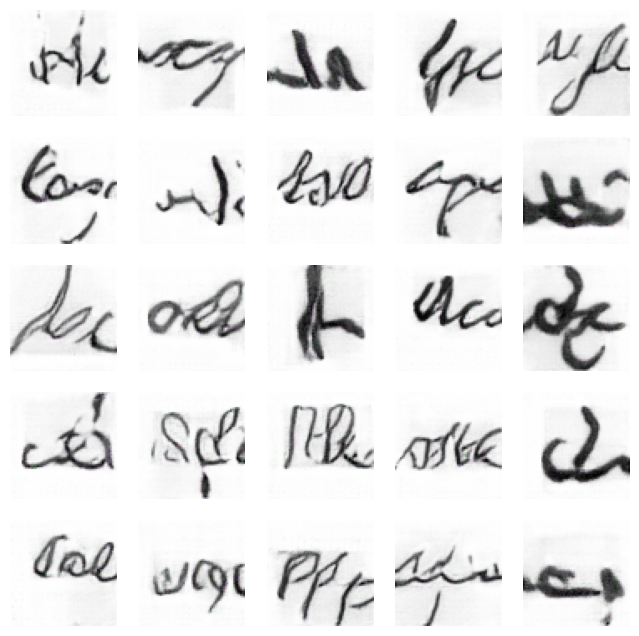

153/153 [==============================] - 373s 2s/step - d_loss: 0.4668 - g_loss: 1.7393
Epoch 69/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4604 - g_loss: 1.7005

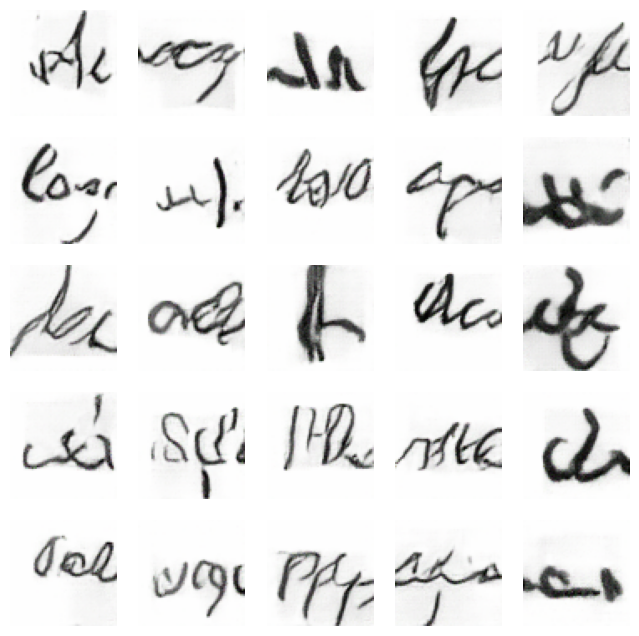

153/153 [==============================] - 372s 2s/step - d_loss: 0.4604 - g_loss: 1.7005
Epoch 70/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4667 - g_loss: 1.7163

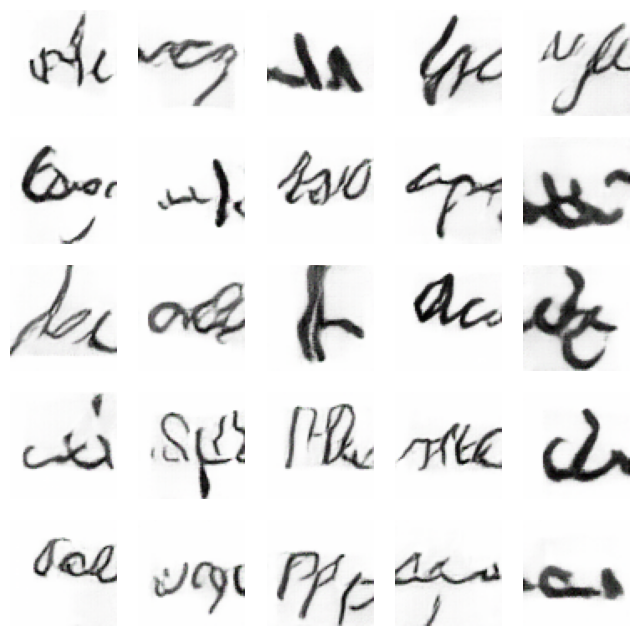

153/153 [==============================] - 371s 2s/step - d_loss: 0.4667 - g_loss: 1.7163
Epoch 71/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4660 - g_loss: 1.7321

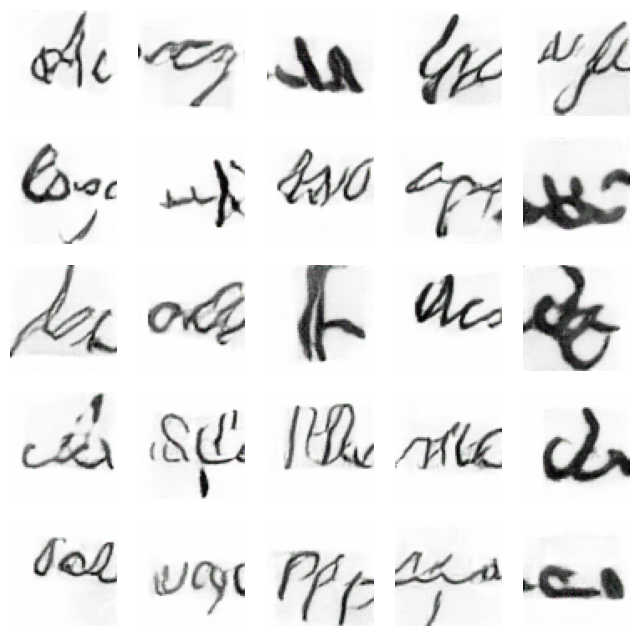

153/153 [==============================] - 373s 2s/step - d_loss: 0.4660 - g_loss: 1.7321
Epoch 72/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4516 - g_loss: 1.7592

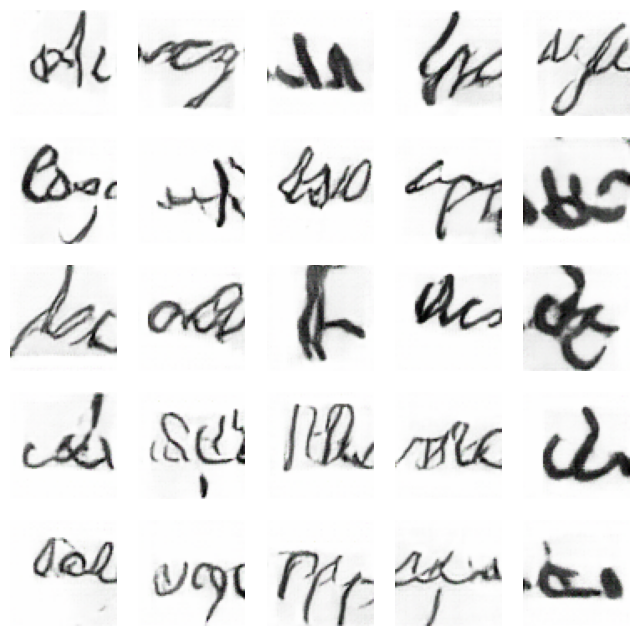

153/153 [==============================] - 373s 2s/step - d_loss: 0.4516 - g_loss: 1.7592
Epoch 73/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4512 - g_loss: 1.7289

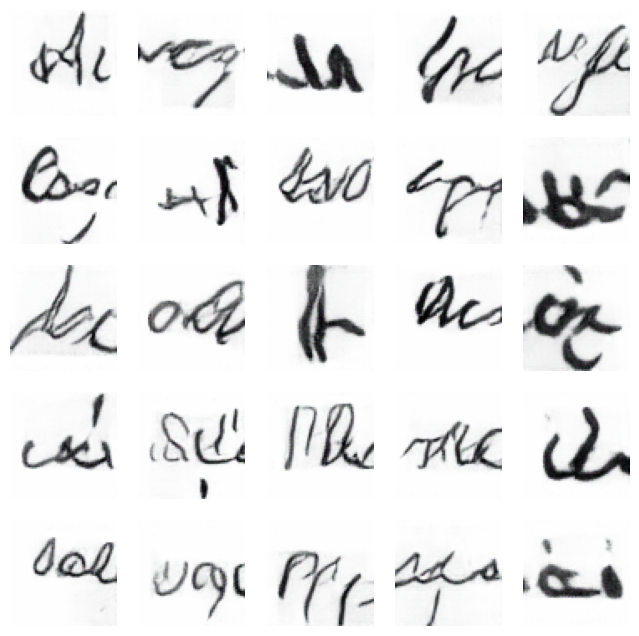

153/153 [==============================] - 375s 2s/step - d_loss: 0.4512 - g_loss: 1.7289
Epoch 74/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4482 - g_loss: 1.7736

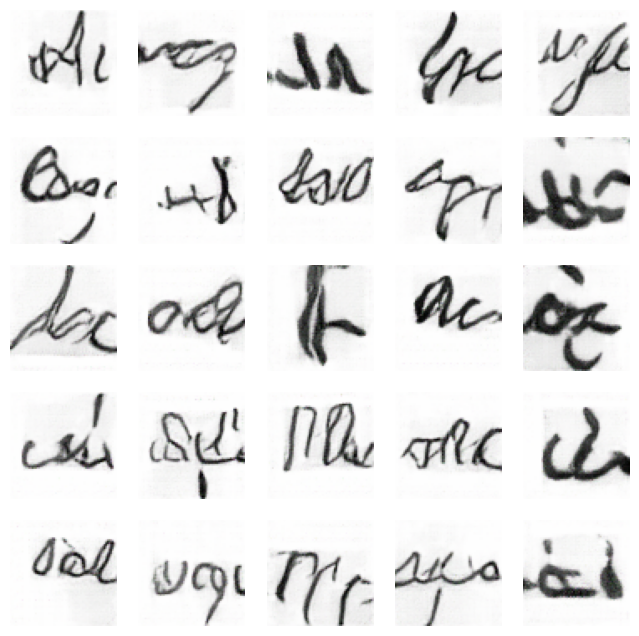

153/153 [==============================] - 374s 2s/step - d_loss: 0.4482 - g_loss: 1.7736
Epoch 75/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4484 - g_loss: 1.7954

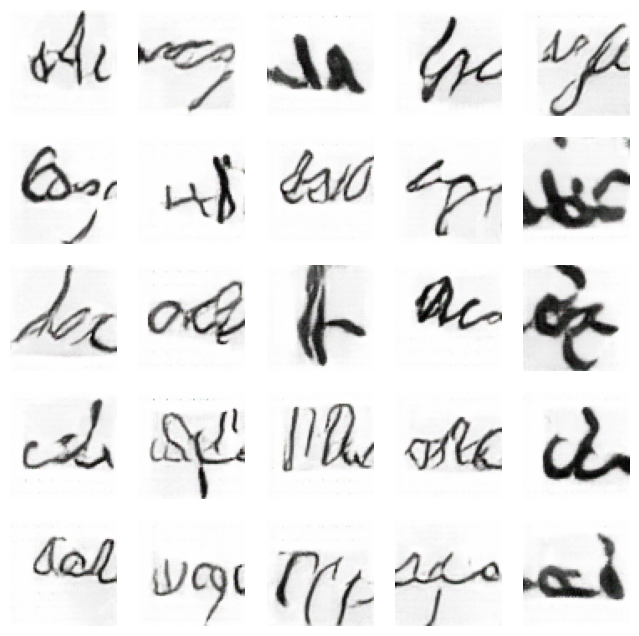

153/153 [==============================] - 372s 2s/step - d_loss: 0.4484 - g_loss: 1.7954
Epoch 76/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4464 - g_loss: 1.7608

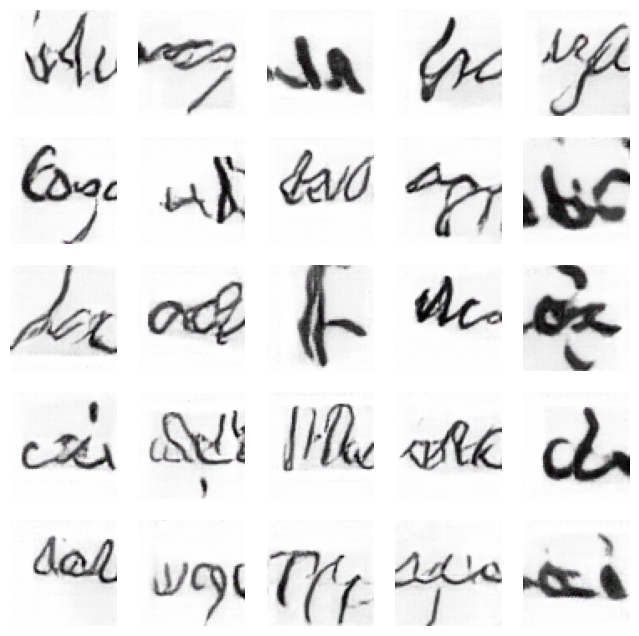

153/153 [==============================] - 371s 2s/step - d_loss: 0.4464 - g_loss: 1.7608
Epoch 77/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4574 - g_loss: 1.7845

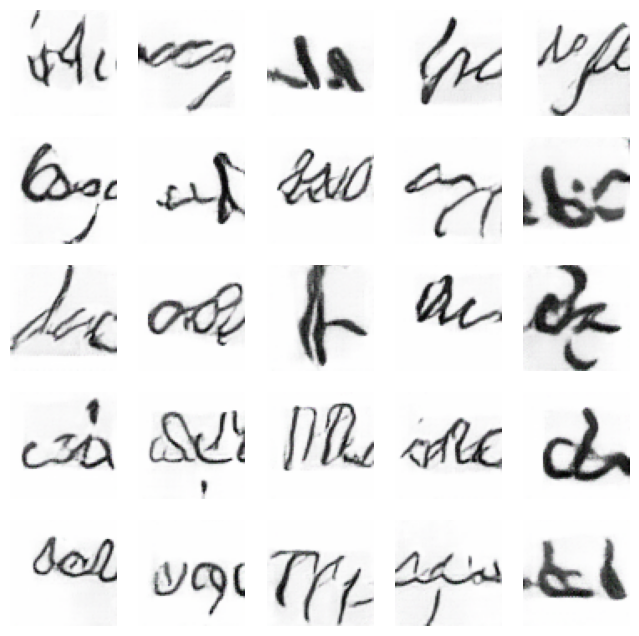

153/153 [==============================] - 372s 2s/step - d_loss: 0.4574 - g_loss: 1.7845
Epoch 78/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4339 - g_loss: 1.8177

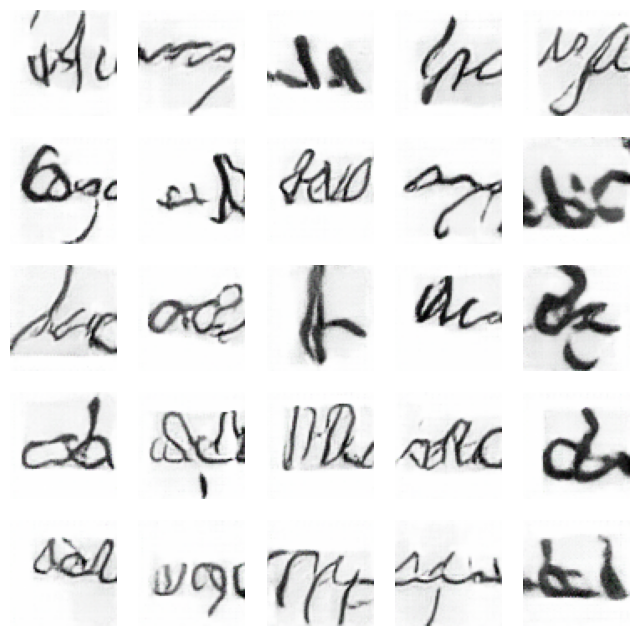

153/153 [==============================] - 374s 2s/step - d_loss: 0.4339 - g_loss: 1.8177
Epoch 79/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4445 - g_loss: 1.7982

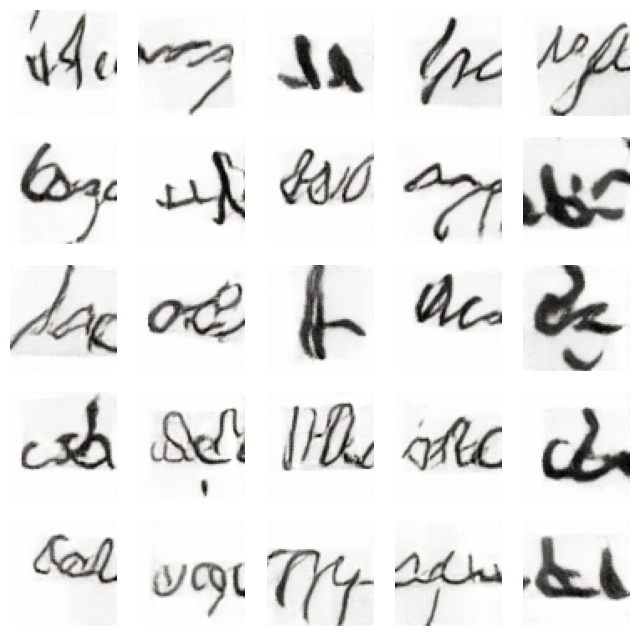

153/153 [==============================] - 378s 2s/step - d_loss: 0.4445 - g_loss: 1.7982
Epoch 80/80
153/153 [==============================] - ETA: 0s - d_loss: 0.4336 - g_loss: 1.8247

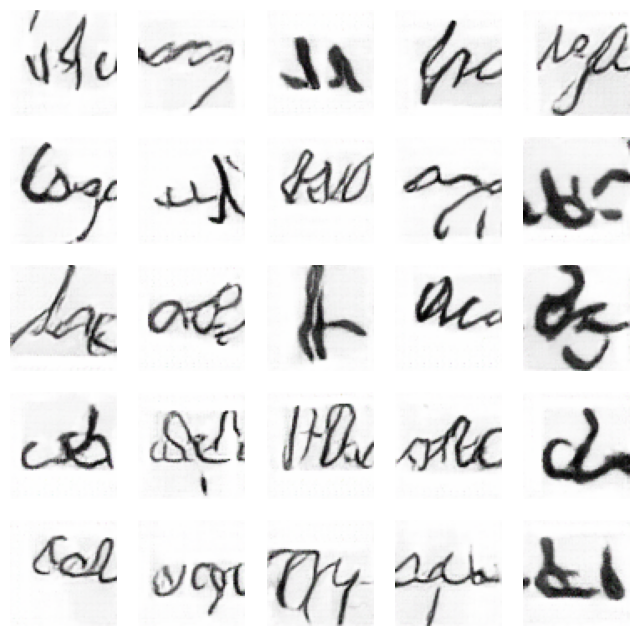

153/153 [==============================] - 376s 2s/step - d_loss: 0.4336 - g_loss: 1.8247


In [ ]:
N_EPOCHS = 80
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

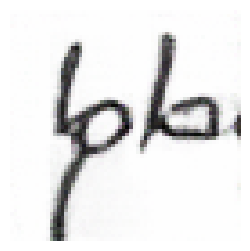

In [ ]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.show()